# Training on online dataset

## Module imports

In [120]:
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torch.nn import MSELoss
from tqdm import tqdm # progress bar
from torch.optim import Adam
import torch
import pickle
import numpy as np

# custom modules
from model import (StentOnlineDataset, # custom on-the-go augmentation dataset
                   UNet) # our PyTorch U-Net model

## Model and cached weight imports

In [121]:
# parameters about cached weights
use_cached_weights = True # use models weights that we cached at checkpoint
path_weights = "./weights/unet-model_7000.pkl" # path to cached weights
previous_iter_count = 7000 # number of iterations we trained the model for before launching this notebook

model = None
if use_cached_weights:
    # load pretrained model with pickle
    with open(path_weights, "rb") as f:
        model = pickle.load(f)
else:
    # create new model
    model = UNet(in_channels=1, out_channels=1)
    # use double precision
    model.double()

## Training Parameters

In [132]:
# parameters used in training
n_images = 2000 # number of images per epoch

# learning rate
lr = 0.00001 # iter 7001 to 10000, excluding base image 7, 8, 9 for better capturing low contrast stents
# lr = 0.00005 # iter 3001 to 7000
# lr = 0.001 # iter 501 to 3000
# lr = 0.005 # iter 1 to 500

# custom image dataset class with on-the-go augmentation
dataset = StentOnlineDataset(n_images=n_images, base_image_path="data/dataset/base_png_with_duplicates")
# pytorch dataset object
data_loader = DataLoader(dataset, batch_size=1, shuffle=False)

In [128]:
# mean square error for avoiding the model to over-whiten the output image when the stent sizes are small
criterion = MSELoss()
optimizer = Adam(model.parameters(), lr=lr)

### Prediction with current weights of the model

Input image:


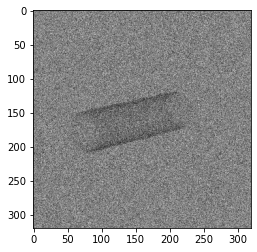

Output image:


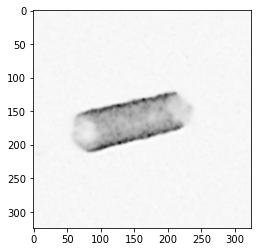

In [129]:
# prediction with current weights
print("Input image:")
plt.figure()
test_input = dataset[0][0]
plt.imshow(test_input[96:-96, 96:-96], cmap="gray")
plt.show()

print("Output image:")
prediction = model(test_input.reshape(1, 512, 512))
plt.figure()
plt.imshow(prediction.detach().numpy()[0], cmap="gray")
plt.show()

In [130]:
# save the losses for analysis
losses = []

  0%|          | 0/3000 [00:00<?, ?it/s]

Epoch [1/1], Step [1/3000], Loss: 0.0002422537
Original image:


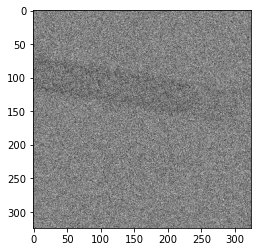

Predicted image:


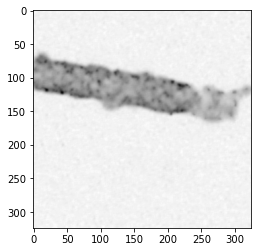

Ground truth:


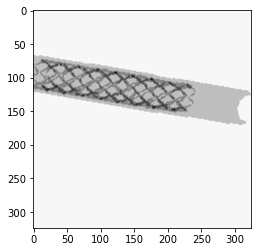

  0%|          | 10/3000 [01:31<7:19:56,  8.83s/it]

Epoch [1/1], Step [11/3000], Loss: 0.0000633114
Original image:


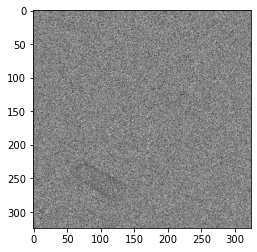

Predicted image:


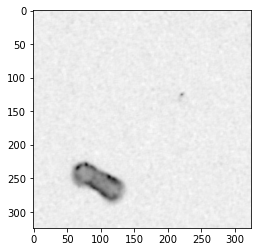

Ground truth:


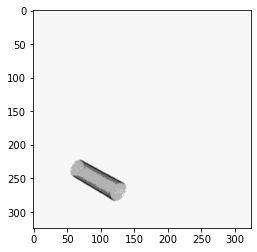

  1%|          | 20/3000 [02:57<7:02:29,  8.51s/it]

Epoch [1/1], Step [21/3000], Loss: 0.0001605196
Original image:


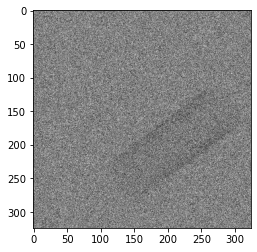

Predicted image:


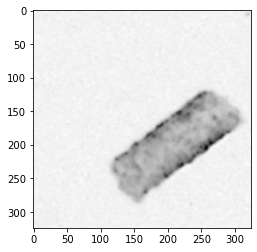

Ground truth:


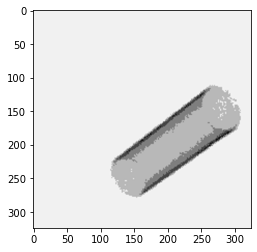

  1%|          | 30/3000 [04:15<6:20:38,  7.69s/it]

Epoch [1/1], Step [31/3000], Loss: 0.0001454405
Original image:


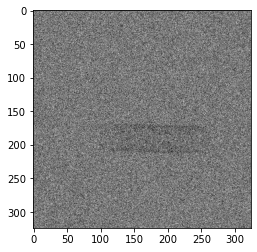

Predicted image:


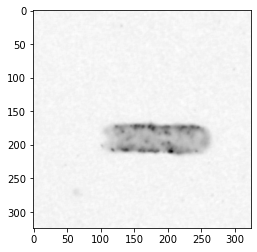

Ground truth:


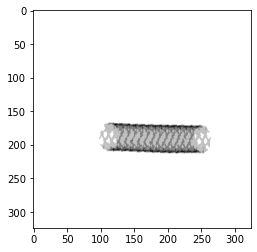

  1%|▏         | 40/3000 [05:31<6:17:22,  7.65s/it]

Epoch [1/1], Step [41/3000], Loss: 0.0001329434
Original image:


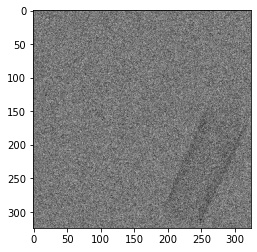

Predicted image:


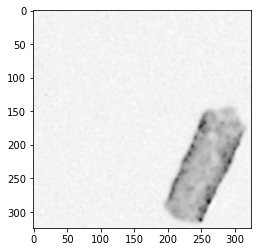

Ground truth:


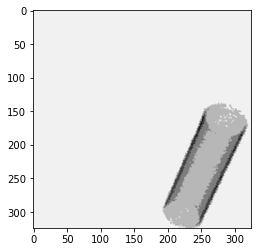

  2%|▏         | 50/3000 [06:46<6:09:43,  7.52s/it]

Epoch [1/1], Step [51/3000], Loss: 0.0001765241
Original image:


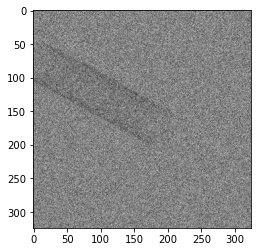

Predicted image:


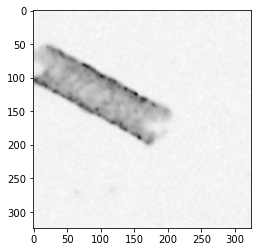

Ground truth:


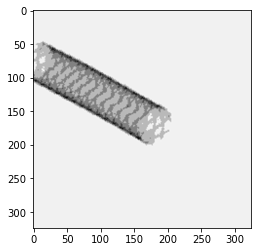

  2%|▏         | 60/3000 [08:02<6:09:09,  7.53s/it]

Epoch [1/1], Step [61/3000], Loss: 0.0002159410
Original image:


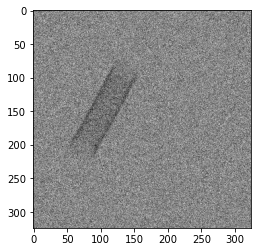

Predicted image:


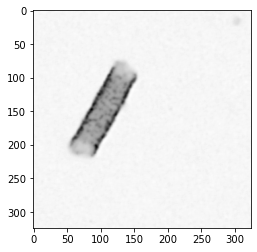

Ground truth:


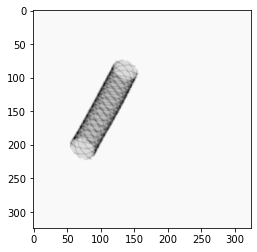

  2%|▏         | 70/3000 [09:18<6:07:52,  7.53s/it]

Epoch [1/1], Step [71/3000], Loss: 0.0001560511
Original image:


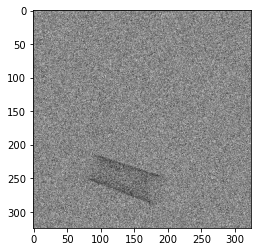

Predicted image:


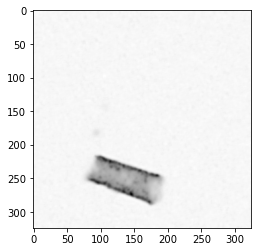

Ground truth:


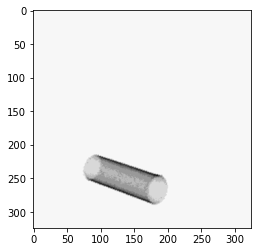

  3%|▎         | 80/3000 [10:34<6:08:45,  7.58s/it]

Epoch [1/1], Step [81/3000], Loss: 0.0000990088
Original image:


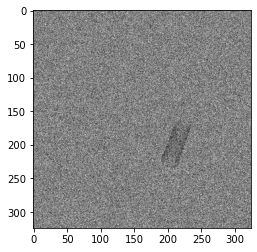

Predicted image:


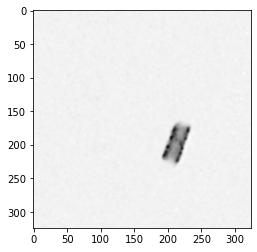

Ground truth:


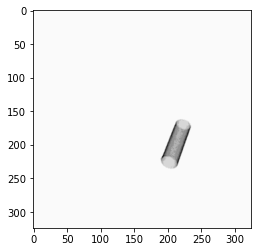

  3%|▎         | 90/3000 [11:51<6:10:55,  7.65s/it]

Epoch [1/1], Step [91/3000], Loss: 0.0000542122
Original image:


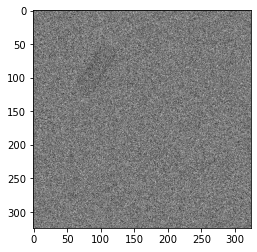

Predicted image:


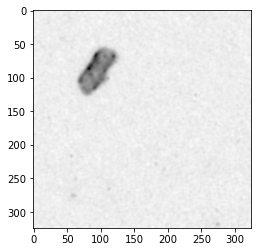

Ground truth:


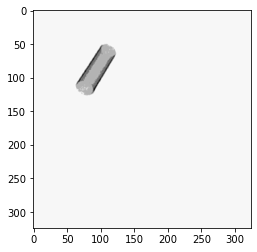

  3%|▎         | 100/3000 [13:08<6:15:36,  7.77s/it]

Epoch [1/1], Step [101/3000], Loss: 0.0000976175
Original image:


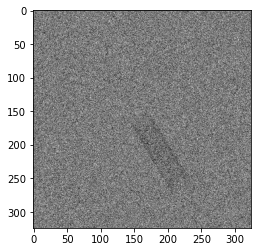

Predicted image:


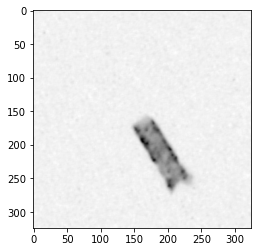

Ground truth:


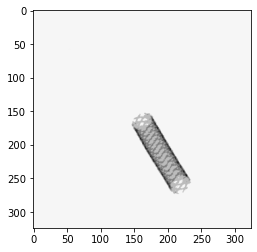

  4%|▎         | 110/3000 [14:25<6:07:28,  7.63s/it]

Epoch [1/1], Step [111/3000], Loss: 0.0001024141
Original image:


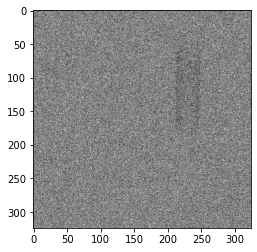

Predicted image:


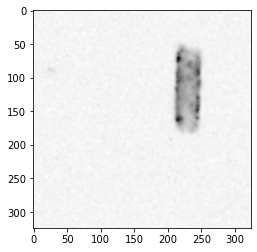

Ground truth:


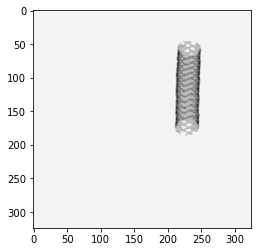

  4%|▍         | 120/3000 [15:41<6:09:19,  7.69s/it]

Epoch [1/1], Step [121/3000], Loss: 0.0003306006
Original image:


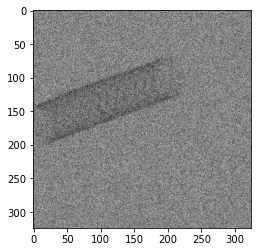

Predicted image:


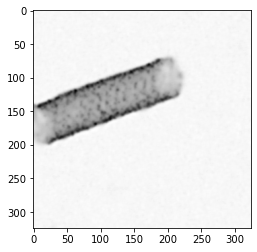

Ground truth:


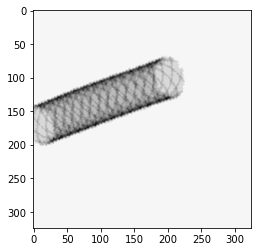

  4%|▍         | 130/3000 [16:59<6:20:15,  7.95s/it]

Epoch [1/1], Step [131/3000], Loss: 0.0000605432
Original image:


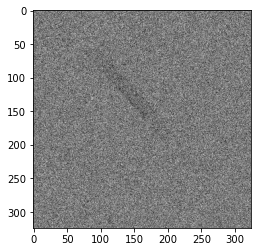

Predicted image:


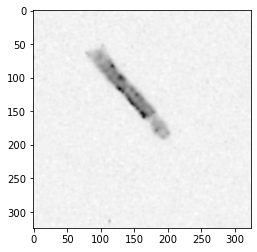

Ground truth:


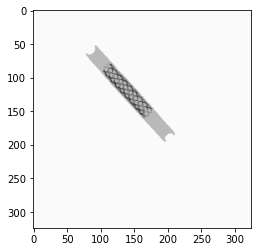

  5%|▍         | 140/3000 [18:17<6:09:49,  7.76s/it]

Epoch [1/1], Step [141/3000], Loss: 0.0003737663
Original image:


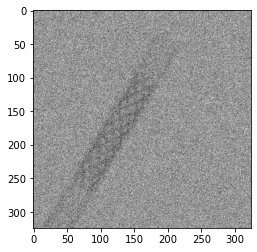

Predicted image:


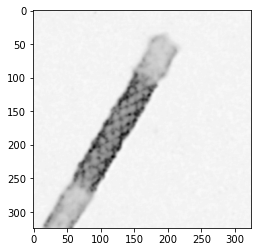

Ground truth:


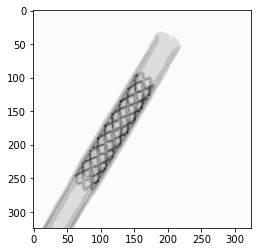

  5%|▌         | 150/3000 [19:34<6:18:22,  7.97s/it]

Epoch [1/1], Step [151/3000], Loss: 0.0004088120
Original image:


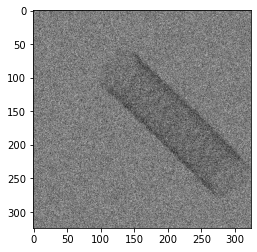

Predicted image:


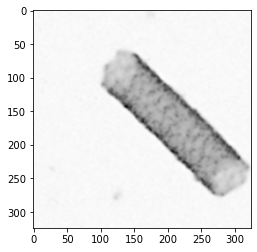

Ground truth:


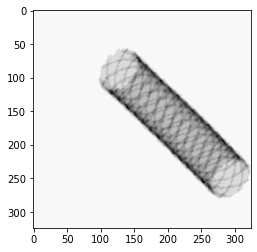

  5%|▌         | 160/3000 [20:51<6:01:28,  7.64s/it]

Epoch [1/1], Step [161/3000], Loss: 0.0001544824
Original image:


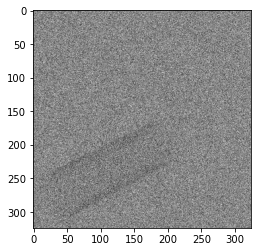

Predicted image:


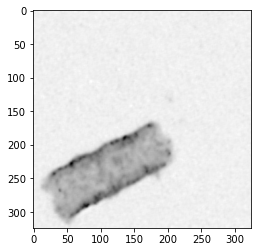

Ground truth:


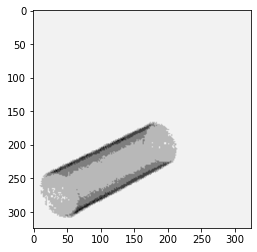

  6%|▌         | 170/3000 [22:07<6:02:09,  7.68s/it]

Epoch [1/1], Step [171/3000], Loss: 0.0001487140
Original image:


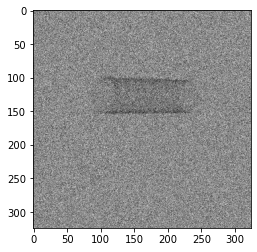

Predicted image:


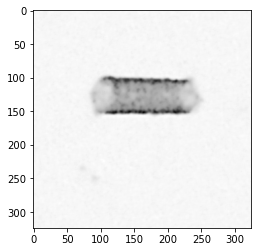

Ground truth:


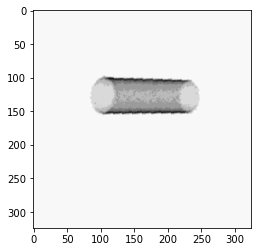

  6%|▌         | 180/3000 [23:23<5:55:43,  7.57s/it]

Epoch [1/1], Step [181/3000], Loss: 0.0001568870
Original image:


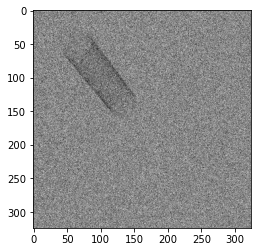

Predicted image:


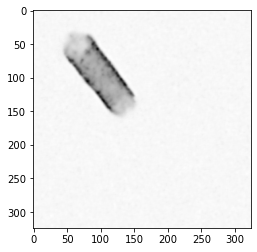

Ground truth:


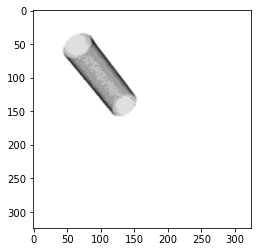

  6%|▋         | 190/3000 [24:40<6:01:30,  7.72s/it]

Epoch [1/1], Step [191/3000], Loss: 0.0003652573
Original image:


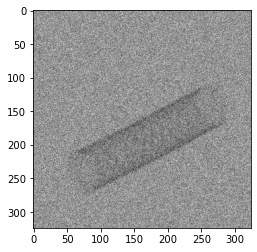

Predicted image:


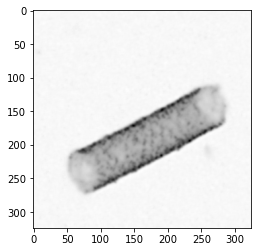

Ground truth:


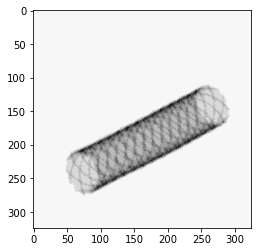

  7%|▋         | 200/3000 [25:58<6:01:59,  7.76s/it]

Epoch [1/1], Step [201/3000], Loss: 0.0001565551
Original image:


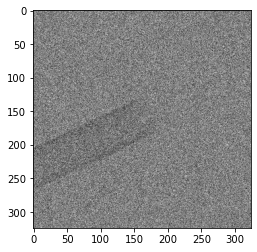

Predicted image:


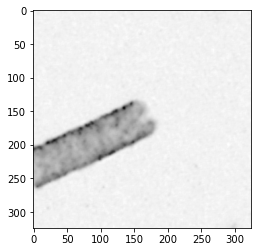

Ground truth:


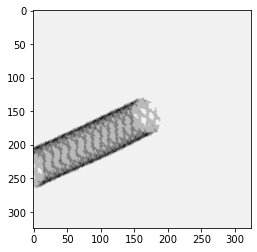

  7%|▋         | 210/3000 [27:16<5:56:50,  7.67s/it]

Epoch [1/1], Step [211/3000], Loss: 0.0001349430
Original image:


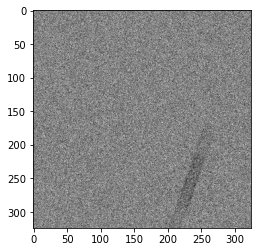

Predicted image:


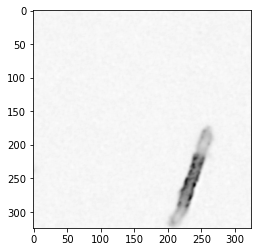

Ground truth:


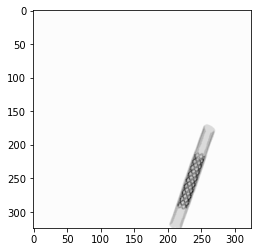

  7%|▋         | 220/3000 [28:33<5:52:47,  7.61s/it]

Epoch [1/1], Step [221/3000], Loss: 0.0002023298
Original image:


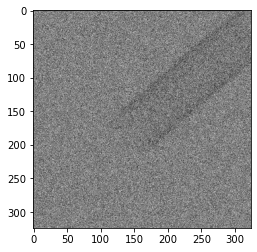

Predicted image:


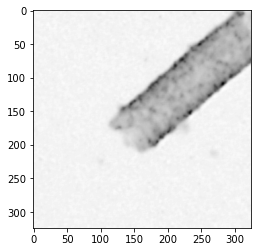

Ground truth:


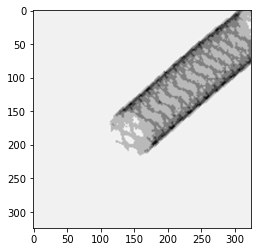

  8%|▊         | 230/3000 [29:52<6:00:50,  7.82s/it]

Epoch [1/1], Step [231/3000], Loss: 0.0000649478
Original image:


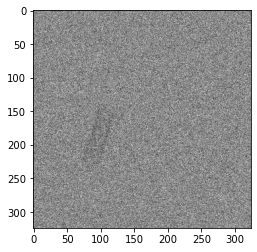

Predicted image:


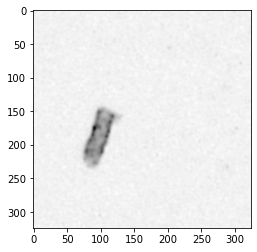

Ground truth:


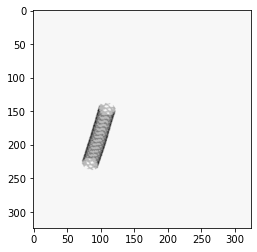

  8%|▊         | 240/3000 [31:10<5:54:11,  7.70s/it]

Epoch [1/1], Step [241/3000], Loss: 0.0001409793
Original image:


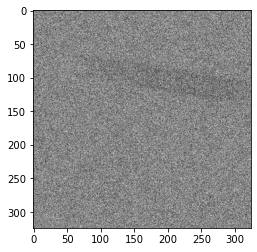

Predicted image:


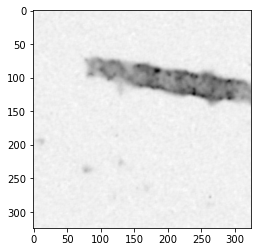

Ground truth:


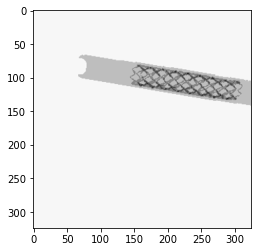

  8%|▊         | 250/3000 [32:28<5:53:10,  7.71s/it]

Epoch [1/1], Step [251/3000], Loss: 0.0000741495
Original image:


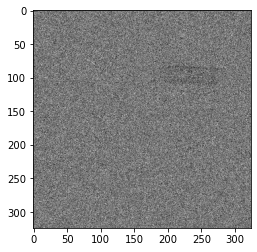

Predicted image:


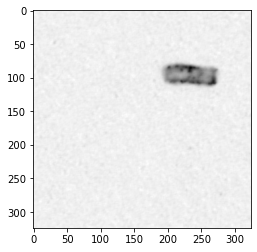

Ground truth:


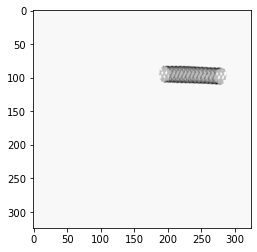

  9%|▊         | 260/3000 [33:45<5:50:16,  7.67s/it]

Epoch [1/1], Step [261/3000], Loss: 0.0002069835
Original image:


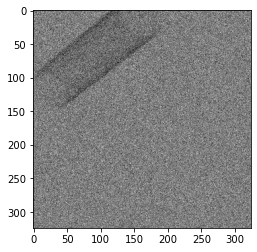

Predicted image:


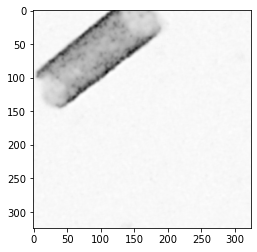

Ground truth:


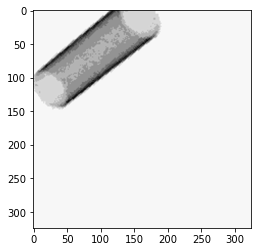

  9%|▉         | 270/3000 [35:06<6:02:06,  7.96s/it]

Epoch [1/1], Step [271/3000], Loss: 0.0000994638
Original image:


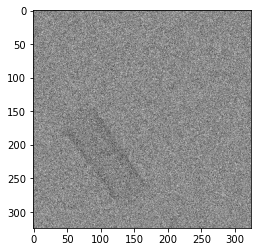

Predicted image:


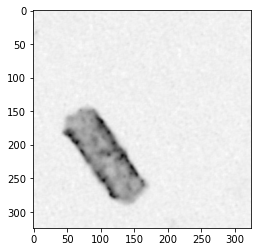

Ground truth:


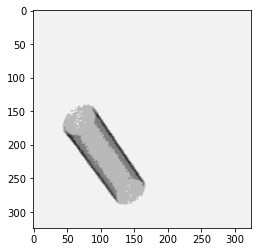

  9%|▉         | 280/3000 [36:26<6:12:12,  8.21s/it]

Epoch [1/1], Step [281/3000], Loss: 0.0001190703
Original image:


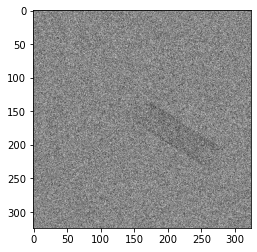

Predicted image:


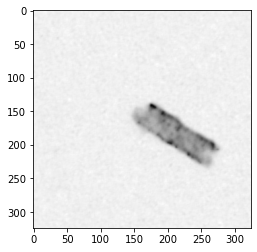

Ground truth:


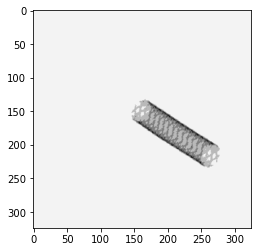

 10%|▉         | 290/3000 [37:47<6:02:53,  8.03s/it]

Epoch [1/1], Step [291/3000], Loss: 0.0003231674
Original image:


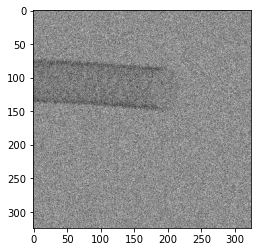

Predicted image:


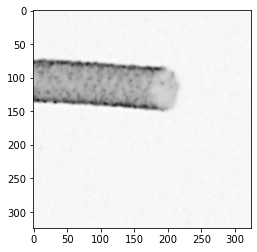

Ground truth:


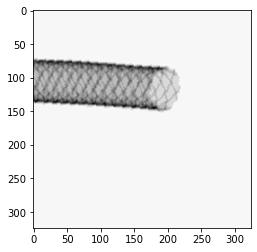

 10%|█         | 300/3000 [39:06<5:56:01,  7.91s/it]

Epoch [1/1], Step [301/3000], Loss: 0.0000629686
Original image:


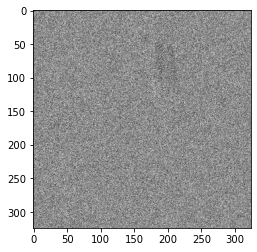

Predicted image:


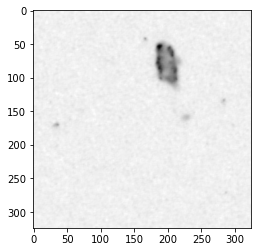

Ground truth:


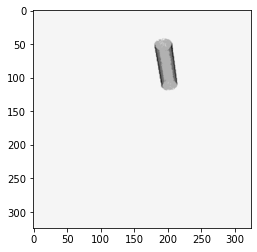

 10%|█         | 310/3000 [40:27<5:57:51,  7.98s/it]

Epoch [1/1], Step [311/3000], Loss: 0.0000604446
Original image:


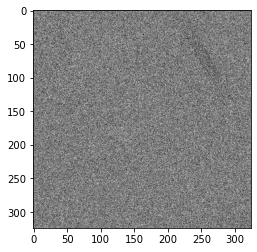

Predicted image:


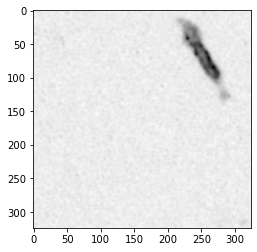

Ground truth:


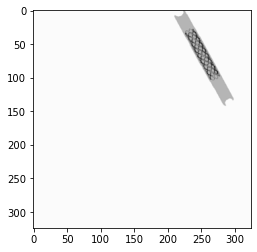

 11%|█         | 320/3000 [41:49<5:56:39,  7.98s/it]

Epoch [1/1], Step [321/3000], Loss: 0.0001497037
Original image:


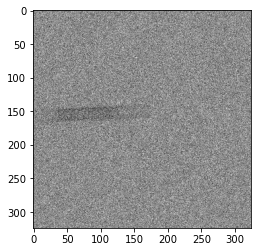

Predicted image:


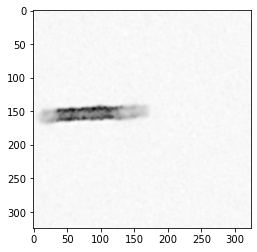

Ground truth:


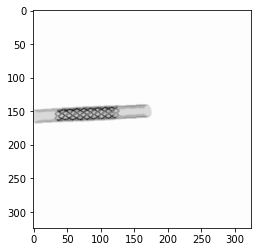

 11%|█         | 330/3000 [43:10<6:07:06,  8.25s/it]

Epoch [1/1], Step [331/3000], Loss: 0.0001480472
Original image:


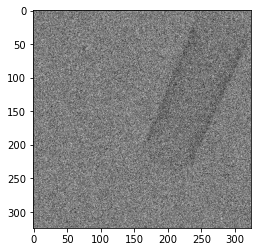

Predicted image:


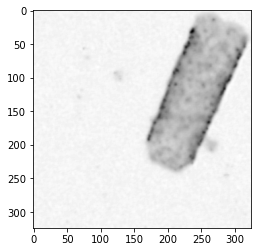

Ground truth:


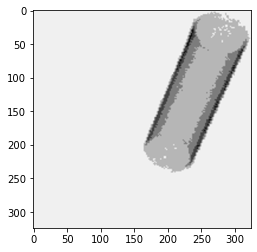

 11%|█▏        | 340/3000 [44:31<5:58:48,  8.09s/it]

Epoch [1/1], Step [341/3000], Loss: 0.0001333308
Original image:


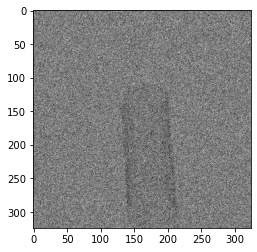

Predicted image:


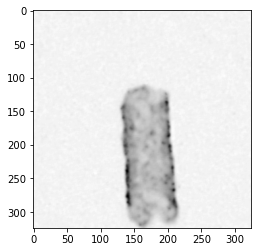

Ground truth:


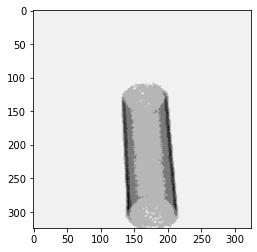

 12%|█▏        | 350/3000 [45:51<5:52:27,  7.98s/it]

Epoch [1/1], Step [351/3000], Loss: 0.0000758937
Original image:


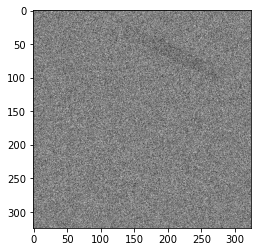

Predicted image:


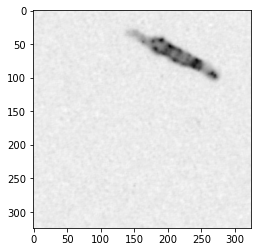

Ground truth:


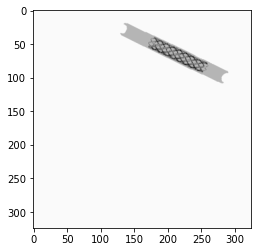

 12%|█▏        | 360/3000 [47:14<6:11:07,  8.43s/it]

Epoch [1/1], Step [361/3000], Loss: 0.0000818265
Original image:


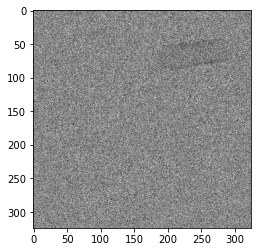

Predicted image:


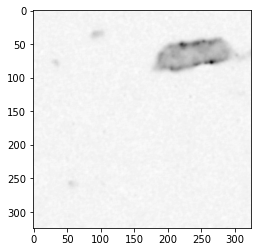

Ground truth:


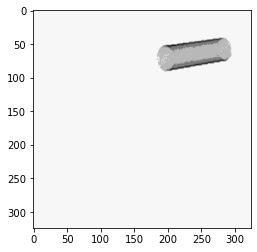

 12%|█▏        | 370/3000 [48:36<6:07:26,  8.38s/it]

Epoch [1/1], Step [371/3000], Loss: 0.0001657226
Original image:


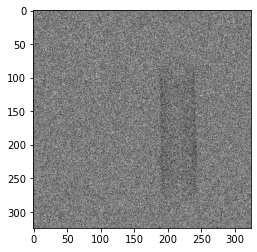

Predicted image:


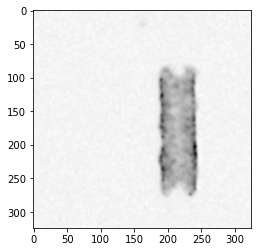

Ground truth:


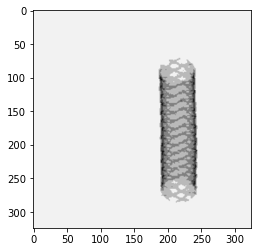

 13%|█▎        | 380/3000 [50:02<6:14:56,  8.59s/it]

Epoch [1/1], Step [381/3000], Loss: 0.0001754994
Original image:


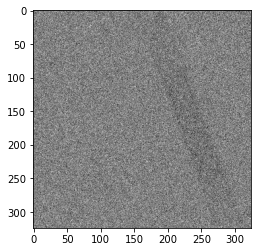

Predicted image:


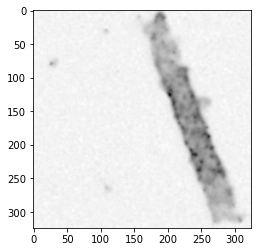

Ground truth:


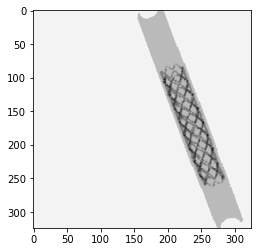

 13%|█▎        | 390/3000 [51:29<6:08:37,  8.47s/it]

Epoch [1/1], Step [391/3000], Loss: 0.0001114156
Original image:


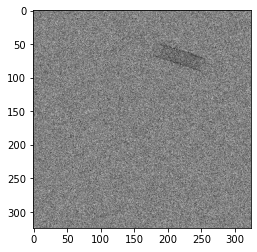

Predicted image:


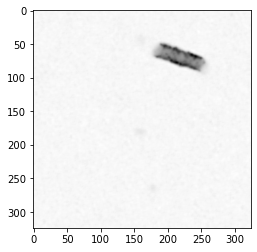

Ground truth:


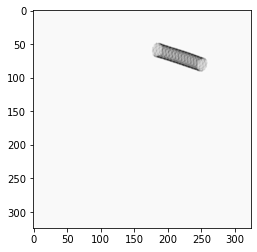

 13%|█▎        | 400/3000 [52:50<5:45:44,  7.98s/it]

Epoch [1/1], Step [401/3000], Loss: 0.0000972723
Original image:


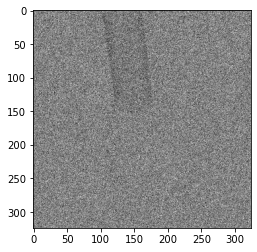

Predicted image:


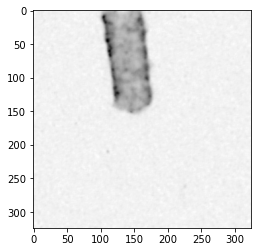

Ground truth:


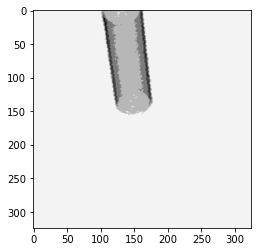

 14%|█▎        | 410/3000 [54:11<5:51:59,  8.15s/it]

Epoch [1/1], Step [411/3000], Loss: 0.0001729935
Original image:


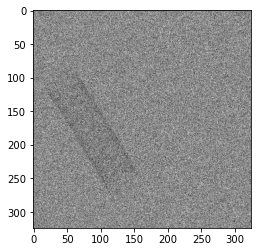

Predicted image:


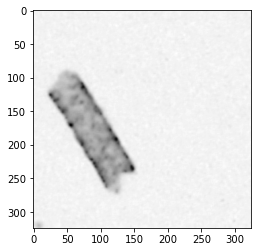

Ground truth:


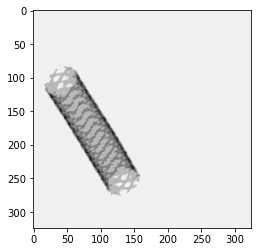

 14%|█▍        | 420/3000 [55:34<5:56:39,  8.29s/it]

Epoch [1/1], Step [421/3000], Loss: 0.0001344871
Original image:


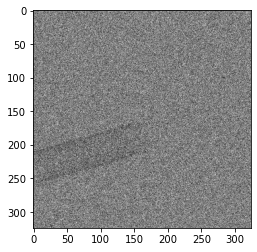

Predicted image:


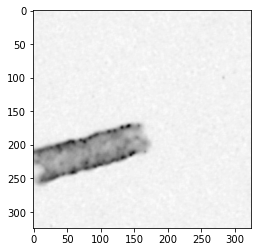

Ground truth:


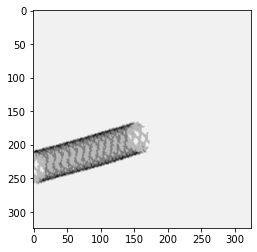

 14%|█▍        | 430/3000 [56:55<5:51:23,  8.20s/it]

Epoch [1/1], Step [431/3000], Loss: 0.0001181467
Original image:


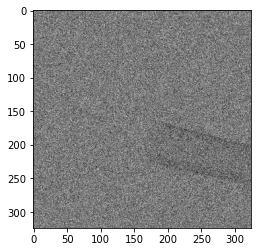

Predicted image:


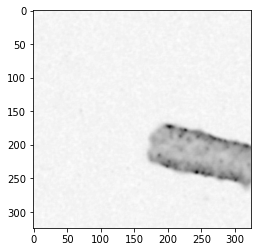

Ground truth:


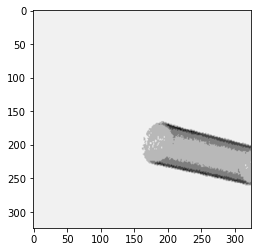

 15%|█▍        | 440/3000 [58:17<5:58:23,  8.40s/it]

Epoch [1/1], Step [441/3000], Loss: 0.0001602002
Original image:


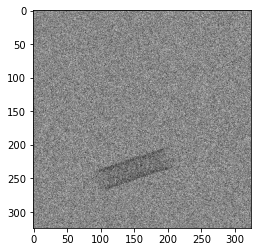

Predicted image:


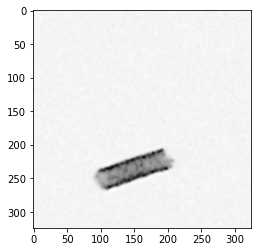

Ground truth:


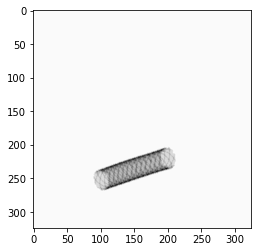

 15%|█▌        | 450/3000 [59:44<6:25:45,  9.08s/it]

Epoch [1/1], Step [451/3000], Loss: 0.0001151743
Original image:


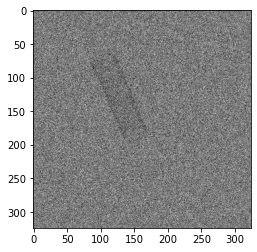

Predicted image:


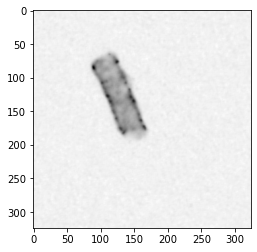

Ground truth:


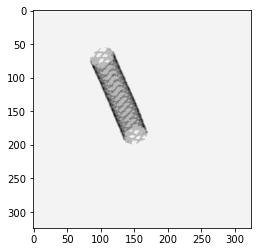

 15%|█▌        | 460/3000 [1:01:07<5:54:59,  8.39s/it]

Epoch [1/1], Step [461/3000], Loss: 0.0000852171
Original image:


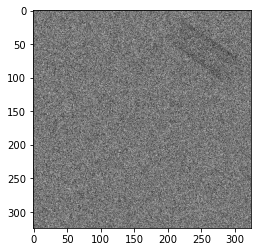

Predicted image:


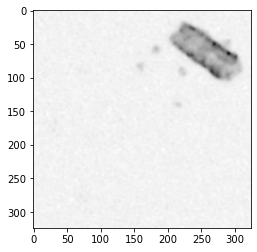

Ground truth:


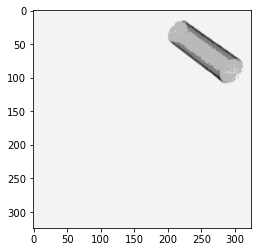

 16%|█▌        | 470/3000 [1:02:27<5:39:03,  8.04s/it]

Epoch [1/1], Step [471/3000], Loss: 0.0001035510
Original image:


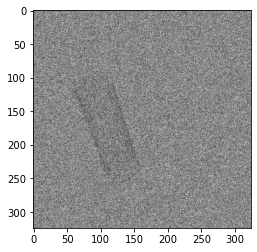

Predicted image:


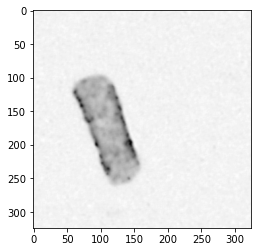

Ground truth:


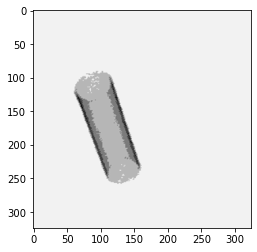

 16%|█▌        | 480/3000 [1:03:49<5:35:57,  8.00s/it]

Epoch [1/1], Step [481/3000], Loss: 0.0001387404
Original image:


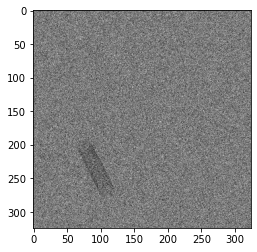

Predicted image:


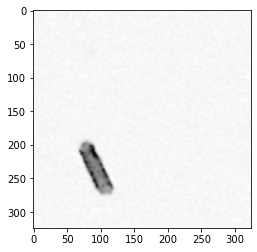

Ground truth:


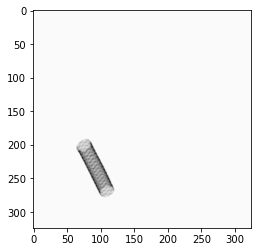

 16%|█▋        | 490/3000 [1:05:11<5:40:09,  8.13s/it]

Epoch [1/1], Step [491/3000], Loss: 0.0000906054
Original image:


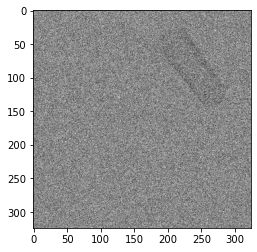

Predicted image:


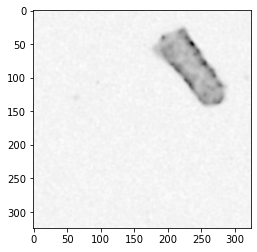

Ground truth:


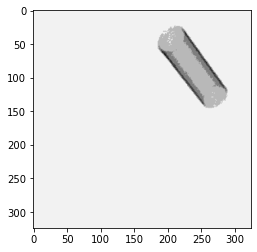

 17%|█▋        | 500/3000 [1:06:34<5:44:37,  8.27s/it]

Epoch [1/1], Step [501/3000], Loss: 0.0003616782
Original image:


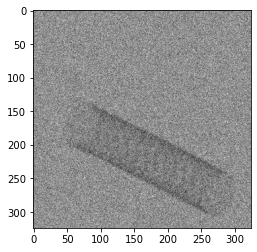

Predicted image:


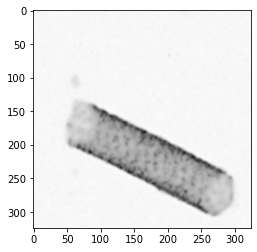

Ground truth:


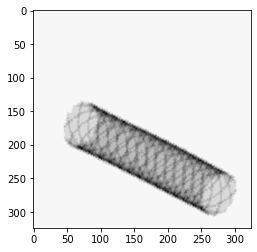

 17%|█▋        | 510/3000 [1:07:55<5:45:52,  8.33s/it]

Epoch [1/1], Step [511/3000], Loss: 0.0002597006
Original image:


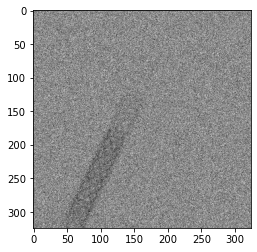

Predicted image:


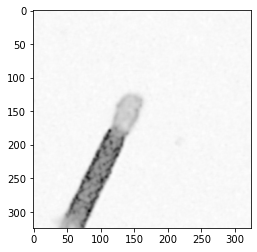

Ground truth:


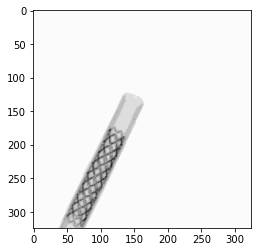

 17%|█▋        | 520/3000 [1:09:17<5:34:35,  8.10s/it]

Epoch [1/1], Step [521/3000], Loss: 0.0002567059
Original image:


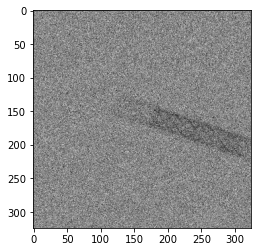

Predicted image:


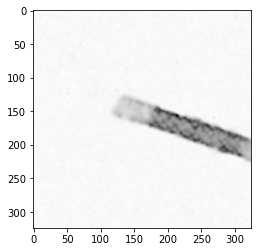

Ground truth:


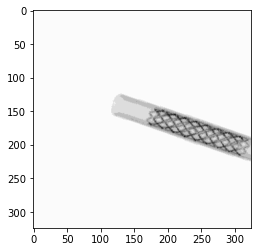

 18%|█▊        | 530/3000 [1:10:44<5:58:38,  8.71s/it]

Epoch [1/1], Step [531/3000], Loss: 0.0000877504
Original image:


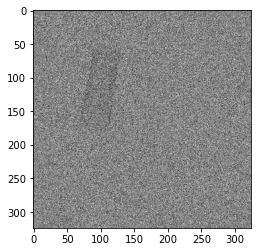

Predicted image:


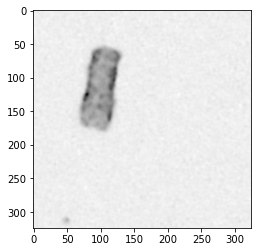

Ground truth:


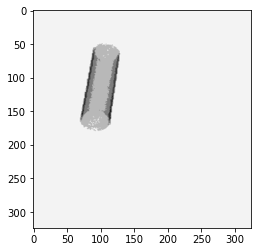

 18%|█▊        | 540/3000 [1:12:14<6:07:06,  8.95s/it]

Epoch [1/1], Step [541/3000], Loss: 0.0001381978
Original image:


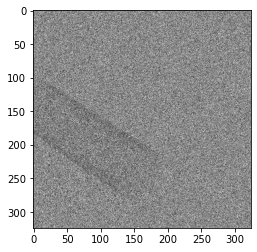

Predicted image:


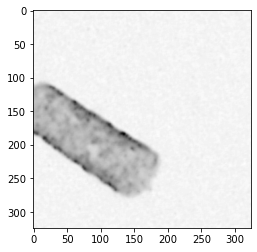

Ground truth:


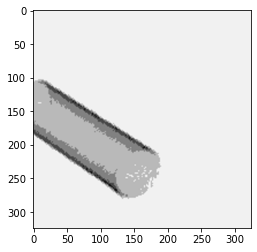

 18%|█▊        | 550/3000 [1:13:47<6:29:04,  9.53s/it]

Epoch [1/1], Step [551/3000], Loss: 0.0001515631
Original image:


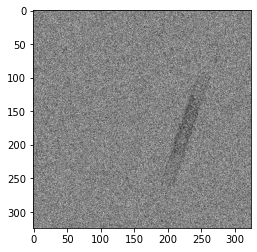

Predicted image:


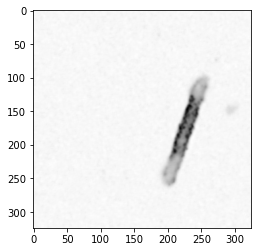

Ground truth:


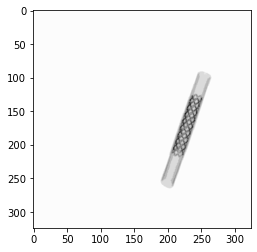

 19%|█▊        | 560/3000 [1:15:18<5:55:52,  8.75s/it]

Epoch [1/1], Step [561/3000], Loss: 0.0000979712
Original image:


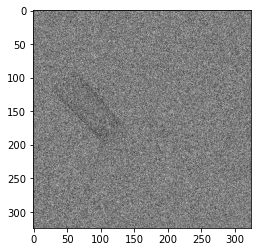

Predicted image:


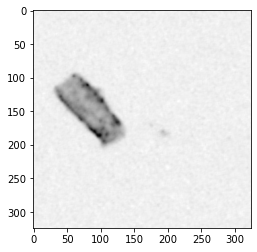

Ground truth:


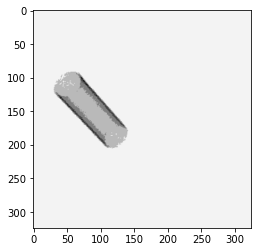

 19%|█▉        | 570/3000 [1:16:47<5:58:43,  8.86s/it]

Epoch [1/1], Step [571/3000], Loss: 0.0001674582
Original image:


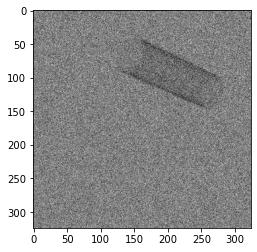

Predicted image:


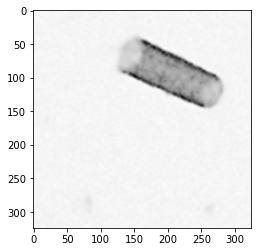

Ground truth:


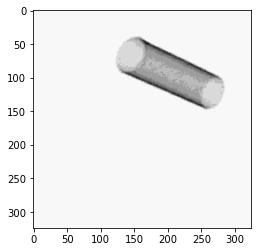

 19%|█▉        | 580/3000 [1:18:14<5:52:29,  8.74s/it]

Epoch [1/1], Step [581/3000], Loss: 0.0001329544
Original image:


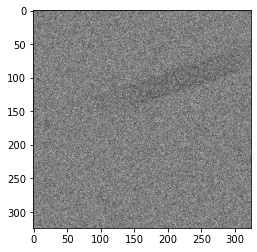

Predicted image:


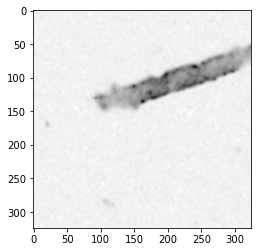

Ground truth:


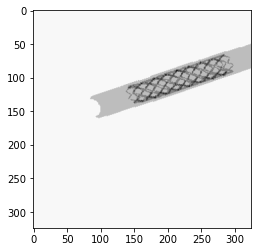

 20%|█▉        | 590/3000 [1:19:44<6:07:20,  9.15s/it]

Epoch [1/1], Step [591/3000], Loss: 0.0002551638
Original image:


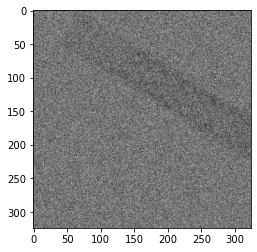

Predicted image:


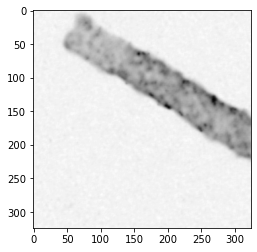

Ground truth:


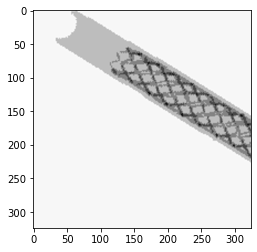

 20%|██        | 600/3000 [1:21:15<6:16:06,  9.40s/it]

Epoch [1/1], Step [601/3000], Loss: 0.0002118512
Original image:


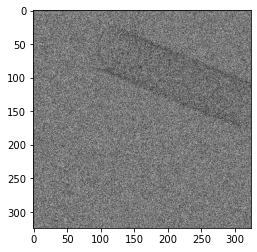

Predicted image:


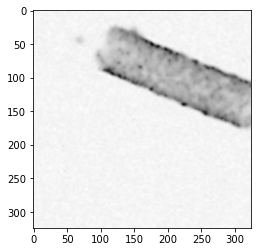

Ground truth:


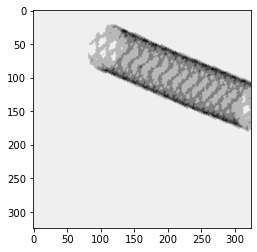

 20%|██        | 610/3000 [1:22:45<6:06:08,  9.19s/it]

Epoch [1/1], Step [611/3000], Loss: 0.0002063602
Original image:


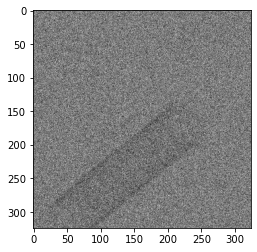

Predicted image:


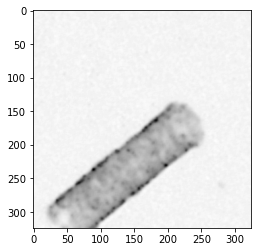

Ground truth:


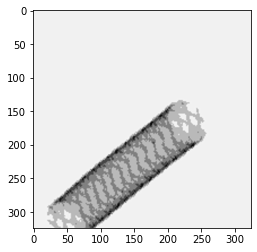

 21%|██        | 620/3000 [1:24:15<6:11:55,  9.38s/it]

Epoch [1/1], Step [621/3000], Loss: 0.0000755698
Original image:


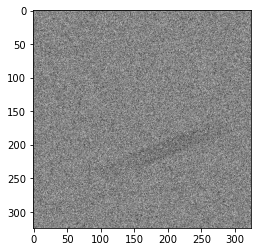

Predicted image:


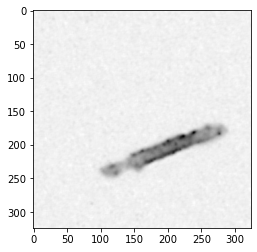

Ground truth:


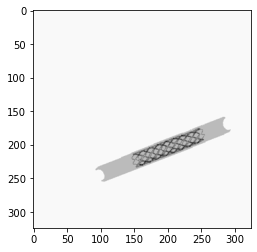

 21%|██        | 630/3000 [1:25:52<6:43:54, 10.23s/it]

Epoch [1/1], Step [631/3000], Loss: 0.0000538220
Original image:


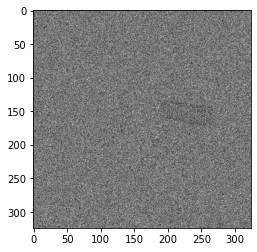

Predicted image:


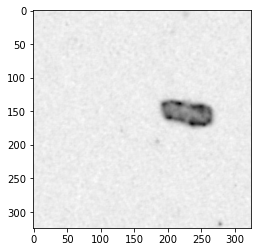

Ground truth:


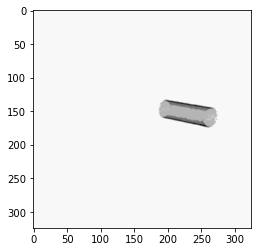

 21%|██▏       | 640/3000 [1:27:24<5:56:35,  9.07s/it]

Epoch [1/1], Step [641/3000], Loss: 0.0001089366
Original image:


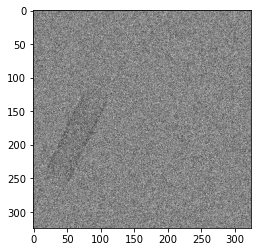

Predicted image:


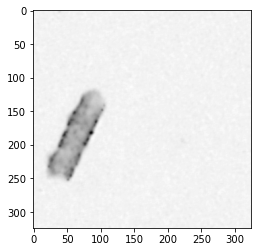

Ground truth:


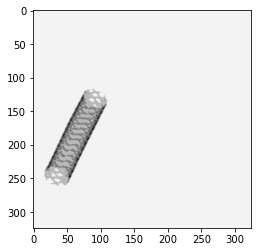

 22%|██▏       | 650/3000 [1:28:57<6:05:42,  9.34s/it]

Epoch [1/1], Step [651/3000], Loss: 0.0001629492
Original image:


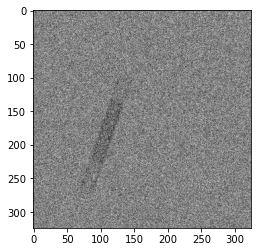

Predicted image:


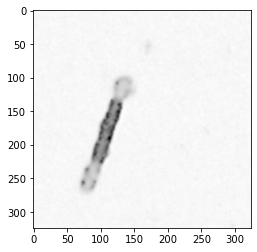

Ground truth:


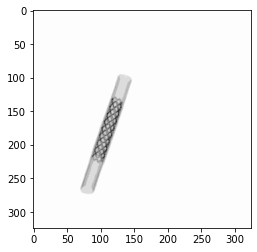

 22%|██▏       | 660/3000 [1:30:31<6:23:08,  9.82s/it]

Epoch [1/1], Step [661/3000], Loss: 0.0000586067
Original image:


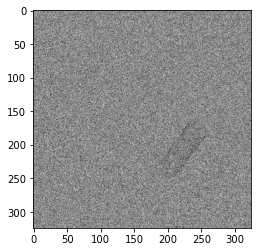

Predicted image:


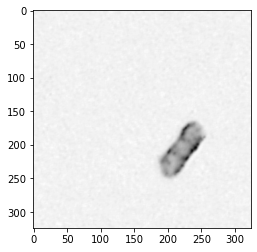

Ground truth:


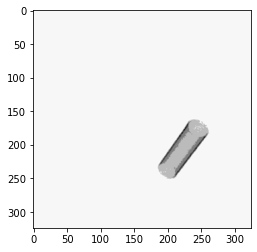

 22%|██▏       | 670/3000 [1:32:02<5:49:58,  9.01s/it]

Epoch [1/1], Step [671/3000], Loss: 0.0002070428
Original image:


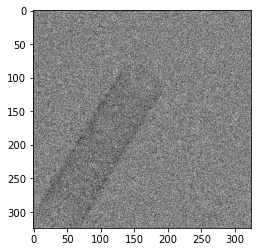

Predicted image:


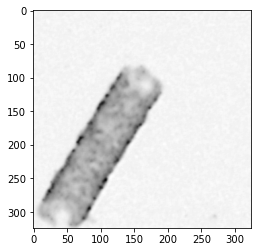

Ground truth:


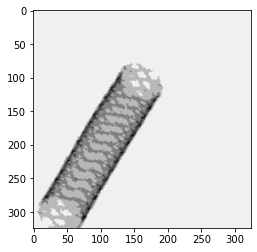

 23%|██▎       | 680/3000 [1:33:31<5:44:29,  8.91s/it]

Epoch [1/1], Step [681/3000], Loss: 0.0001283580
Original image:


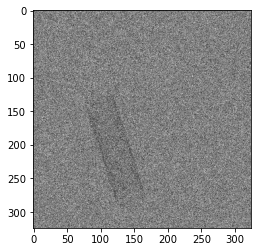

Predicted image:


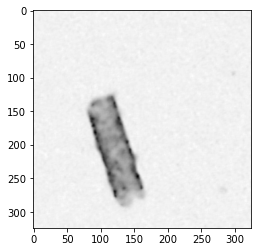

Ground truth:


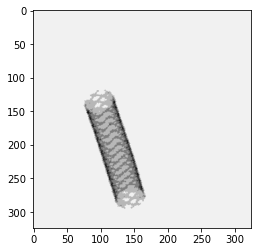

 23%|██▎       | 690/3000 [1:35:01<5:35:54,  8.72s/it]

Epoch [1/1], Step [691/3000], Loss: 0.0002171708
Original image:


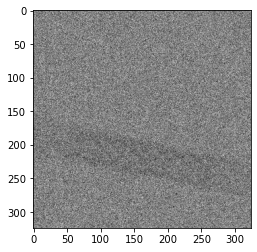

Predicted image:


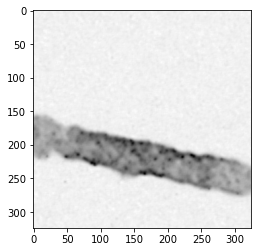

Ground truth:


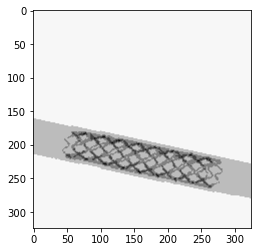

 23%|██▎       | 700/3000 [1:36:31<5:51:47,  9.18s/it]

Epoch [1/1], Step [701/3000], Loss: 0.0000541017
Original image:


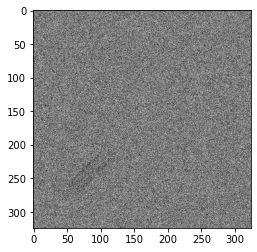

Predicted image:


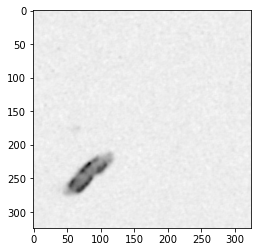

Ground truth:


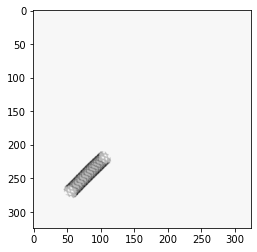

 24%|██▎       | 710/3000 [1:38:03<5:45:20,  9.05s/it]

Epoch [1/1], Step [711/3000], Loss: 0.0000696432
Original image:


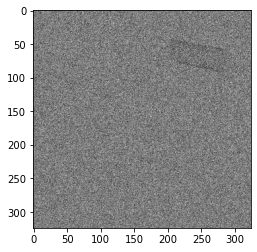

Predicted image:


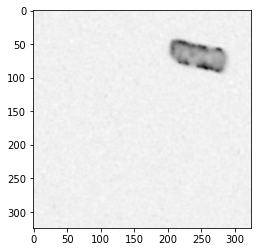

Ground truth:


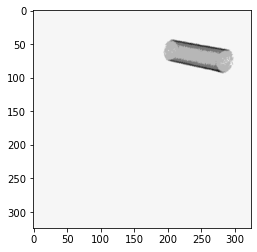

 24%|██▍       | 720/3000 [1:39:38<5:57:17,  9.40s/it]

Epoch [1/1], Step [721/3000], Loss: 0.0000563094
Original image:


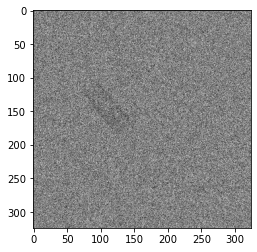

Predicted image:


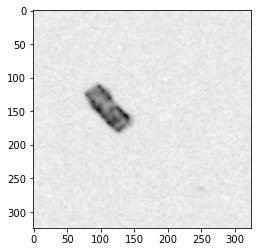

Ground truth:


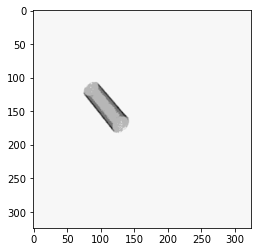

 24%|██▍       | 730/3000 [1:41:12<6:07:05,  9.70s/it]

Epoch [1/1], Step [731/3000], Loss: 0.0001774361
Original image:


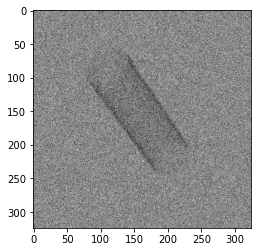

Predicted image:


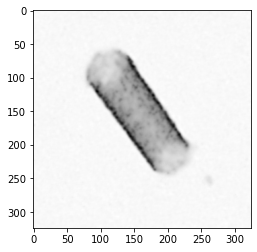

Ground truth:


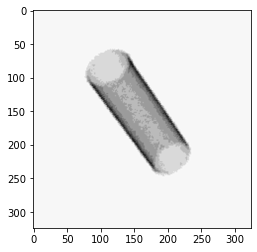

 25%|██▍       | 740/3000 [1:42:48<6:21:44, 10.13s/it]

Epoch [1/1], Step [741/3000], Loss: 0.0000747305
Original image:


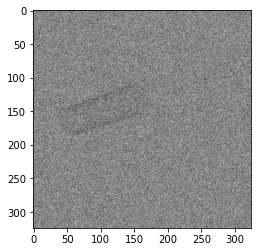

Predicted image:


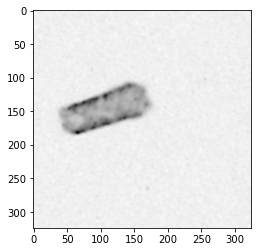

Ground truth:


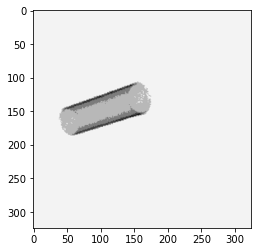

 25%|██▌       | 750/3000 [1:44:23<5:59:16,  9.58s/it]

Epoch [1/1], Step [751/3000], Loss: 0.0001990552
Original image:


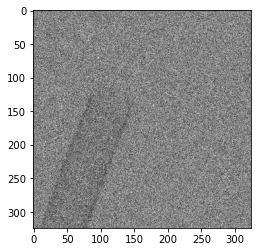

Predicted image:


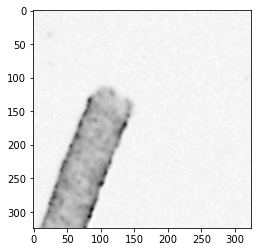

Ground truth:


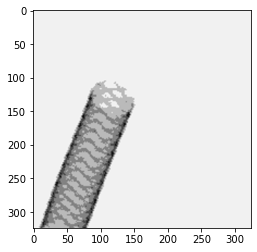

 25%|██▌       | 760/3000 [1:45:58<5:50:45,  9.40s/it]

Epoch [1/1], Step [761/3000], Loss: 0.0000878800
Original image:


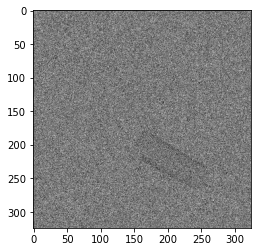

Predicted image:


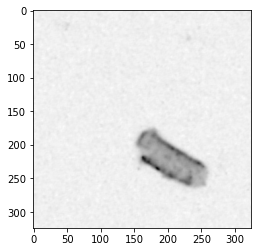

Ground truth:


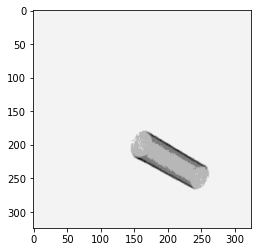

 26%|██▌       | 770/3000 [1:47:33<5:57:47,  9.63s/it]

Epoch [1/1], Step [771/3000], Loss: 0.0001397267
Original image:


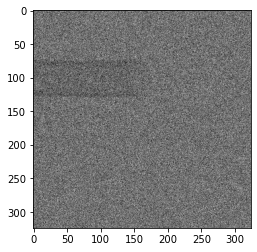

Predicted image:


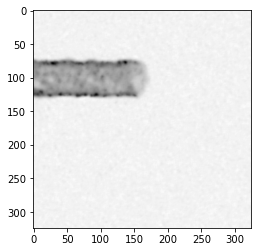

Ground truth:


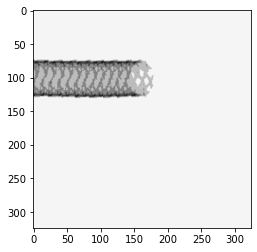

 26%|██▌       | 780/3000 [1:49:10<6:12:05, 10.06s/it]

Epoch [1/1], Step [781/3000], Loss: 0.0003002570
Original image:


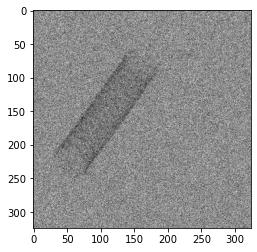

Predicted image:


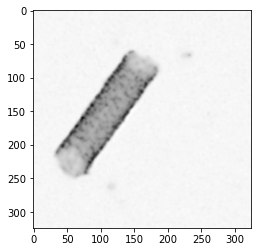

Ground truth:


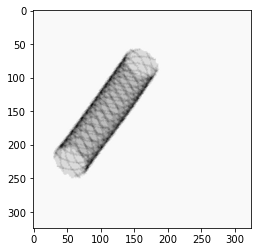

 26%|██▋       | 790/3000 [1:50:45<5:43:33,  9.33s/it]

Epoch [1/1], Step [791/3000], Loss: 0.0002624767
Original image:


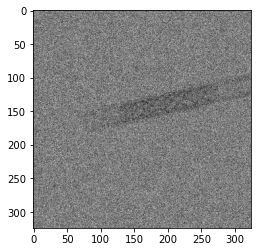

Predicted image:


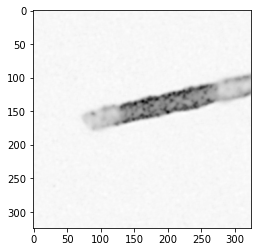

Ground truth:


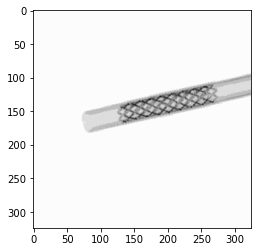

 27%|██▋       | 800/3000 [1:52:19<5:37:42,  9.21s/it]

Epoch [1/1], Step [801/3000], Loss: 0.0004596474
Original image:


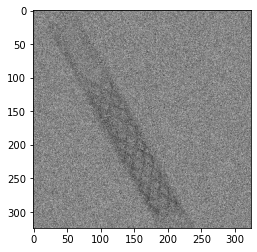

Predicted image:


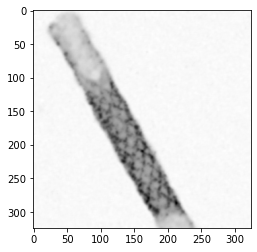

Ground truth:


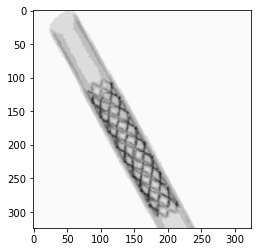

 27%|██▋       | 810/3000 [1:53:56<6:01:47,  9.91s/it]

Epoch [1/1], Step [811/3000], Loss: 0.0001330335
Original image:


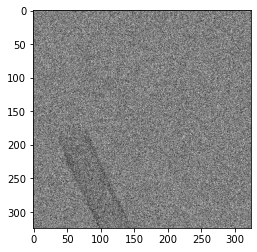

Predicted image:


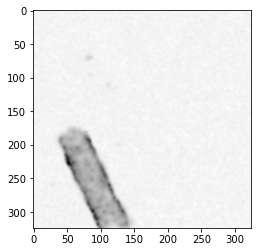

Ground truth:


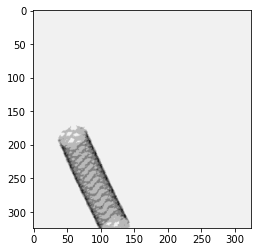

 27%|██▋       | 820/3000 [1:55:33<6:04:18, 10.03s/it]

Epoch [1/1], Step [821/3000], Loss: 0.0001656313
Original image:


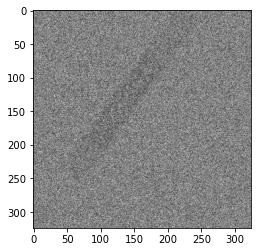

Predicted image:


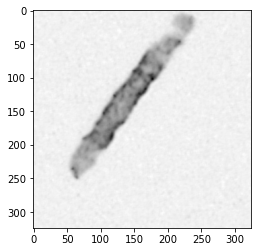

Ground truth:


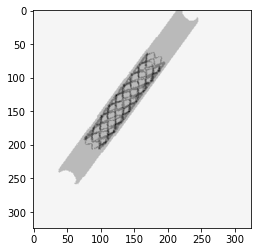

 28%|██▊       | 830/3000 [1:57:06<5:28:10,  9.07s/it]

Epoch [1/1], Step [831/3000], Loss: 0.0004052247
Original image:


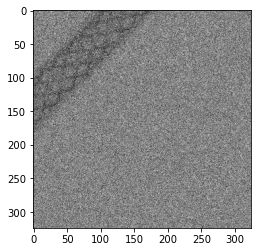

Predicted image:


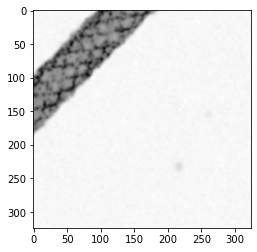

Ground truth:


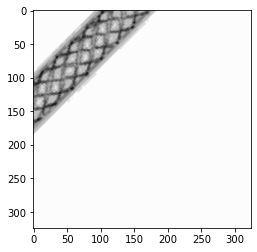

 28%|██▊       | 840/3000 [1:58:39<5:30:02,  9.17s/it]

Epoch [1/1], Step [841/3000], Loss: 0.0000855591
Original image:


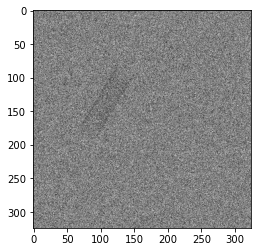

Predicted image:


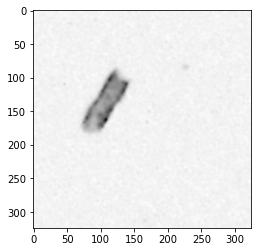

Ground truth:


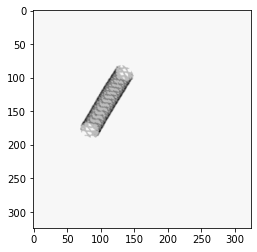

 28%|██▊       | 850/3000 [2:00:09<5:17:56,  8.87s/it]

Epoch [1/1], Step [851/3000], Loss: 0.0001568108
Original image:


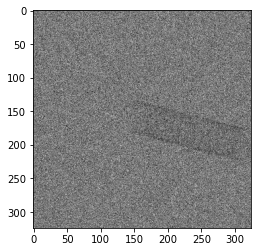

Predicted image:


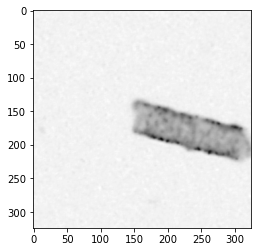

Ground truth:


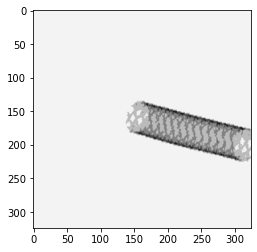

 29%|██▊       | 860/3000 [2:01:49<5:54:47,  9.95s/it]

Epoch [1/1], Step [861/3000], Loss: 0.0000684305
Original image:


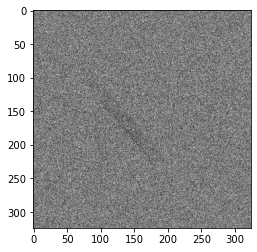

Predicted image:


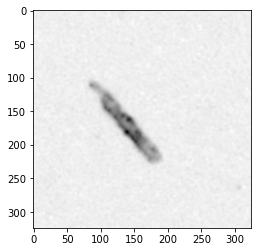

Ground truth:


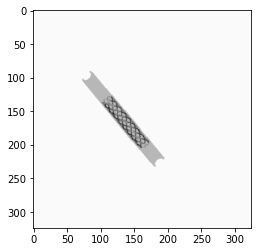

 29%|██▉       | 870/3000 [2:03:29<6:00:08, 10.14s/it]

Epoch [1/1], Step [871/3000], Loss: 0.0002064521
Original image:


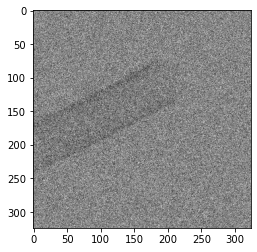

Predicted image:


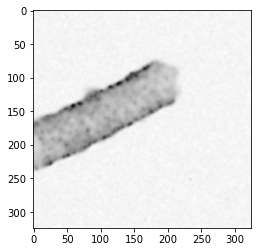

Ground truth:


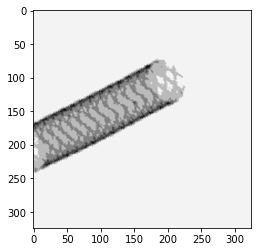

 29%|██▉       | 880/3000 [2:05:06<5:50:31,  9.92s/it]

Epoch [1/1], Step [881/3000], Loss: 0.0001933993
Original image:


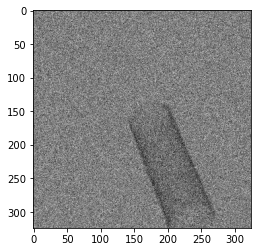

Predicted image:


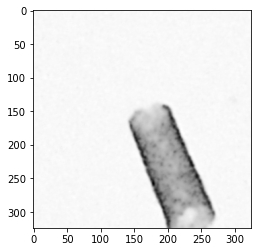

Ground truth:


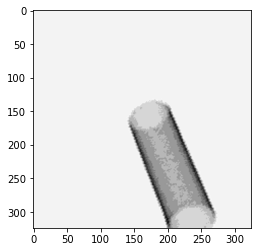

 30%|██▉       | 890/3000 [2:06:46<6:10:17, 10.53s/it]

Epoch [1/1], Step [891/3000], Loss: 0.0000733274
Original image:


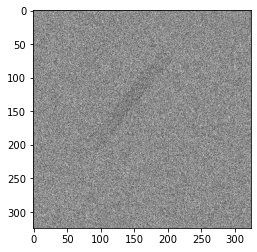

Predicted image:


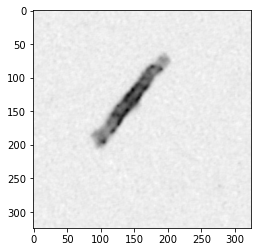

Ground truth:


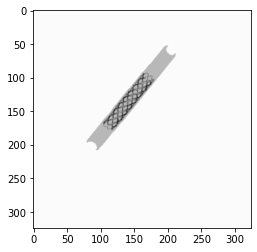

 30%|███       | 900/3000 [2:08:23<6:04:00, 10.40s/it]

Epoch [1/1], Step [901/3000], Loss: 0.0001811137
Original image:


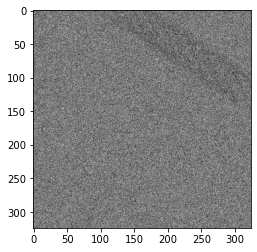

Predicted image:


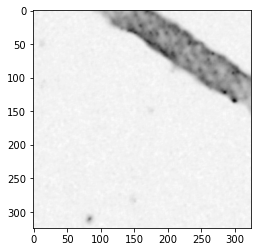

Ground truth:


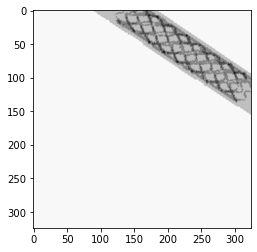

 30%|███       | 910/3000 [2:10:04<6:06:47, 10.53s/it]

Epoch [1/1], Step [911/3000], Loss: 0.0002620424
Original image:


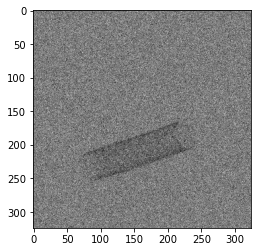

Predicted image:


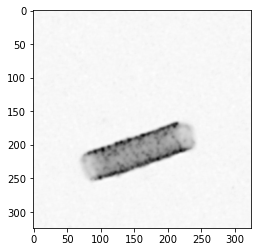

Ground truth:


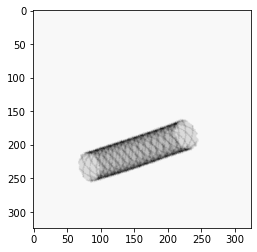

 31%|███       | 920/3000 [2:11:44<5:59:11, 10.36s/it]

Epoch [1/1], Step [921/3000], Loss: 0.0001996416
Original image:


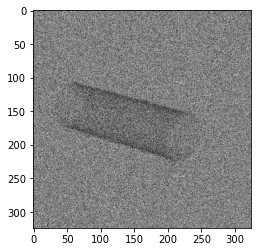

Predicted image:


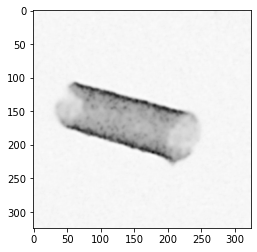

Ground truth:


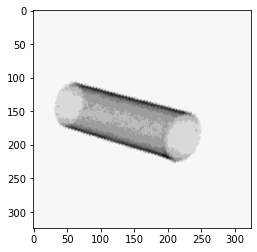

 31%|███       | 930/3000 [2:13:24<5:35:31,  9.73s/it]

Epoch [1/1], Step [931/3000], Loss: 0.0001409377
Original image:


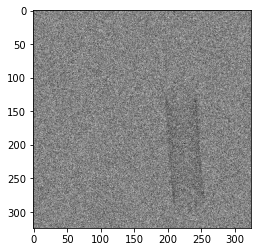

Predicted image:


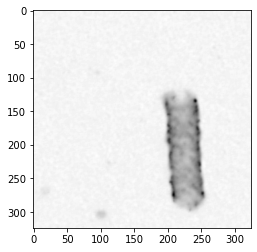

Ground truth:


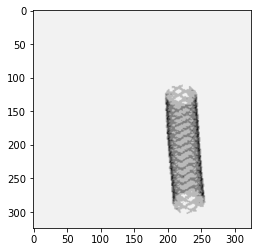

 31%|███▏      | 940/3000 [2:15:01<5:29:27,  9.60s/it]

Epoch [1/1], Step [941/3000], Loss: 0.0001915817
Original image:


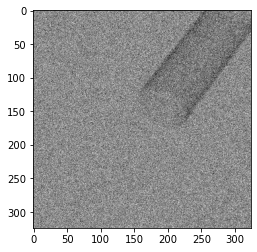

Predicted image:


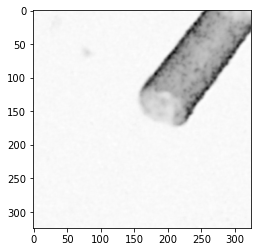

Ground truth:


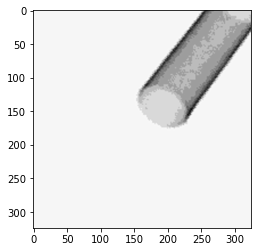

 32%|███▏      | 950/3000 [2:16:40<5:27:35,  9.59s/it]

Epoch [1/1], Step [951/3000], Loss: 0.0001864395
Original image:


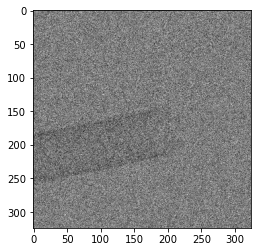

Predicted image:


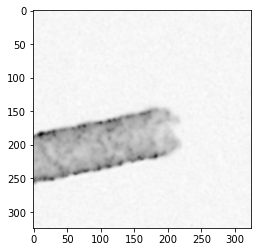

Ground truth:


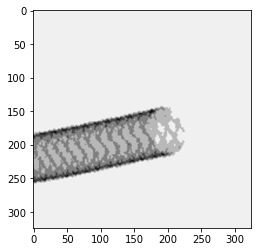

 32%|███▏      | 960/3000 [2:18:22<5:32:39,  9.78s/it]

Epoch [1/1], Step [961/3000], Loss: 0.0002001113
Original image:


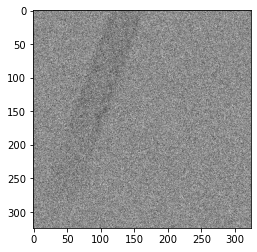

Predicted image:


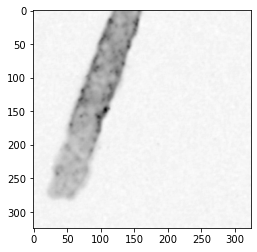

Ground truth:


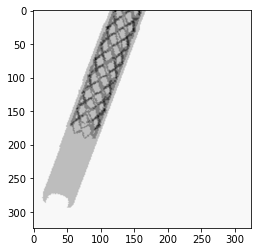

 32%|███▏      | 970/3000 [2:20:04<5:32:03,  9.81s/it]

Epoch [1/1], Step [971/3000], Loss: 0.0004979232
Original image:


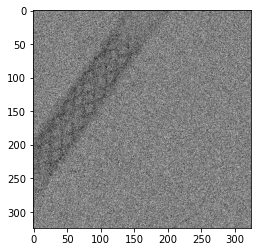

Predicted image:


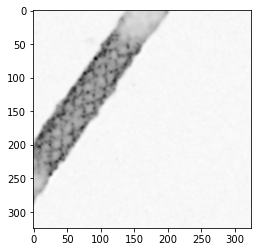

Ground truth:


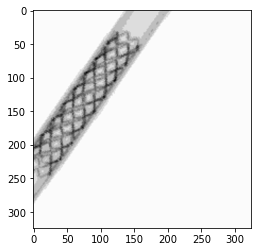

 33%|███▎      | 980/3000 [2:21:46<5:33:01,  9.89s/it]

Epoch [1/1], Step [981/3000], Loss: 0.0001413841
Original image:


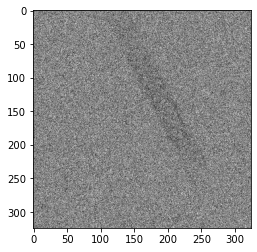

Predicted image:


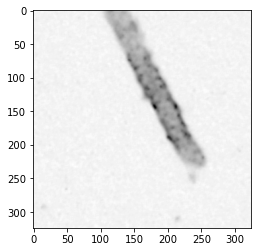

Ground truth:


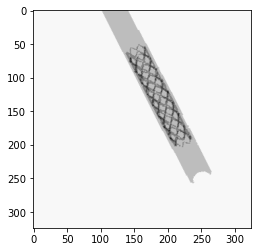

 33%|███▎      | 990/3000 [2:23:26<5:26:46,  9.75s/it]

Epoch [1/1], Step [991/3000], Loss: 0.0001302503
Original image:


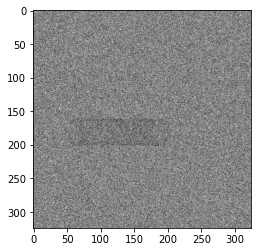

Predicted image:


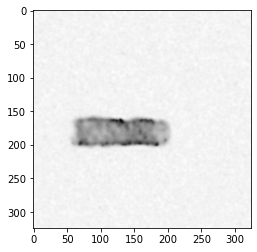

Ground truth:


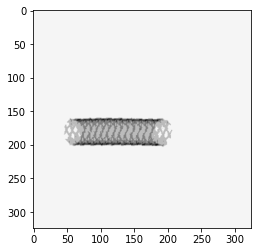

 33%|███▎      | 1000/3000 [2:25:11<5:34:25, 10.03s/it]

Epoch [1/1], Step [1001/3000], Loss: 0.0001736515
Original image:


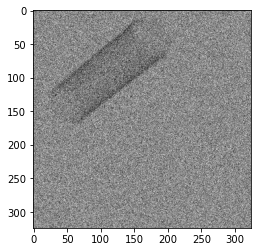

Predicted image:


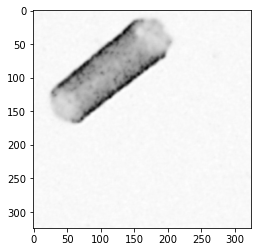

Ground truth:


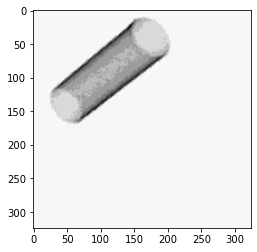

 34%|███▎      | 1010/3000 [2:26:50<5:25:25,  9.81s/it]

Epoch [1/1], Step [1011/3000], Loss: 0.0000951945
Original image:


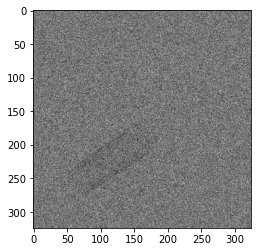

Predicted image:


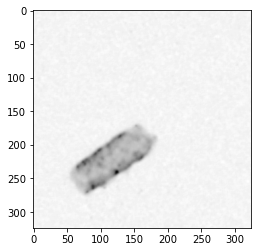

Ground truth:


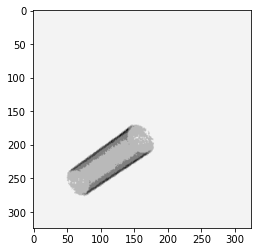

 34%|███▍      | 1020/3000 [2:28:33<5:45:13, 10.46s/it]

Epoch [1/1], Step [1021/3000], Loss: 0.0002648960
Original image:


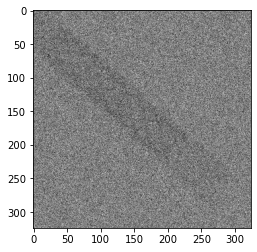

Predicted image:


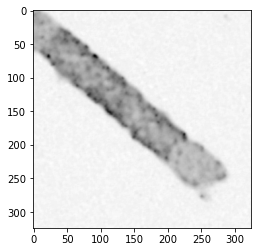

Ground truth:


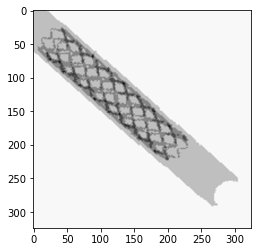

 34%|███▍      | 1030/3000 [2:30:22<5:57:58, 10.90s/it]

Epoch [1/1], Step [1031/3000], Loss: 0.0003065807
Original image:


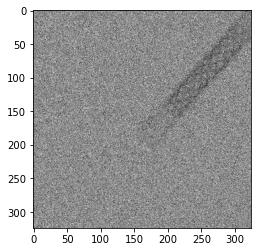

Predicted image:


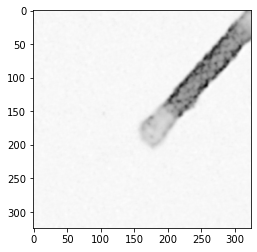

Ground truth:


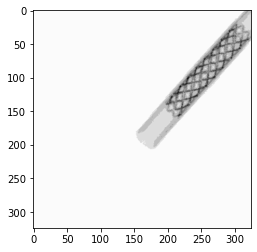

 35%|███▍      | 1040/3000 [2:31:59<5:26:04,  9.98s/it]

Epoch [1/1], Step [1041/3000], Loss: 0.0003441002
Original image:


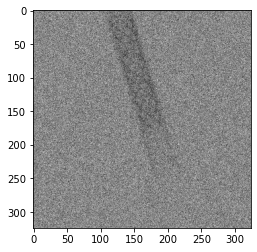

Predicted image:


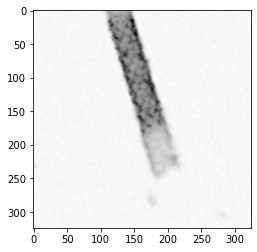

Ground truth:


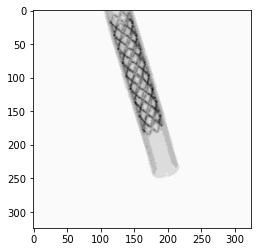

 35%|███▌      | 1050/3000 [2:33:43<5:21:12,  9.88s/it]

Epoch [1/1], Step [1051/3000], Loss: 0.0002113573
Original image:


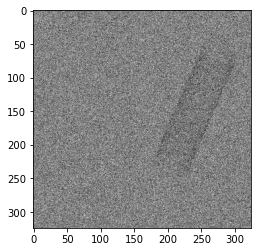

Predicted image:


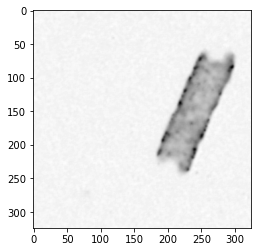

Ground truth:


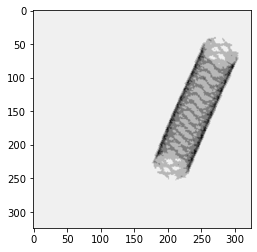

 35%|███▌      | 1060/3000 [2:35:27<5:22:18,  9.97s/it]

Epoch [1/1], Step [1061/3000], Loss: 0.0000906930
Original image:


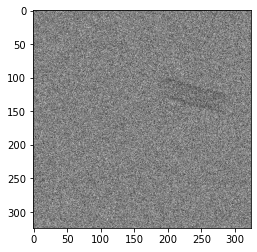

Predicted image:


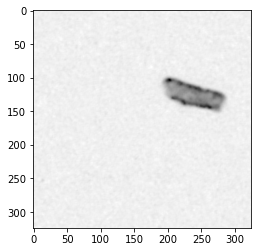

Ground truth:


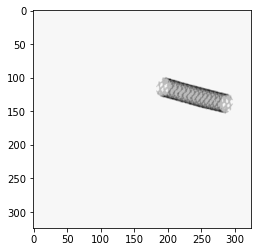

 36%|███▌      | 1070/3000 [2:37:10<5:19:49,  9.94s/it]

Epoch [1/1], Step [1071/3000], Loss: 0.0001775980
Original image:


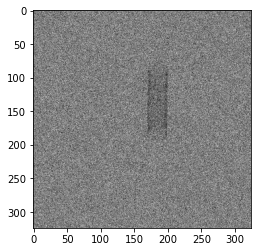

Predicted image:


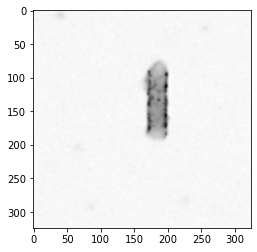

Ground truth:


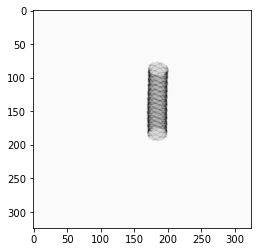

 36%|███▌      | 1080/3000 [2:38:57<5:49:37, 10.93s/it]

Epoch [1/1], Step [1081/3000], Loss: 0.0001008229
Original image:


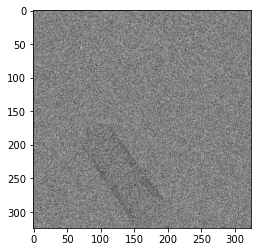

Predicted image:


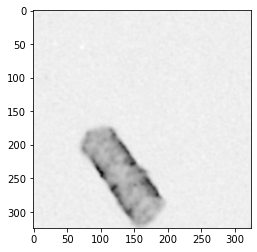

Ground truth:


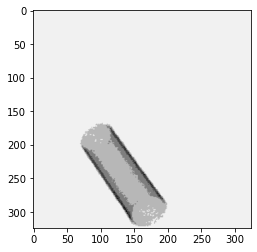

 36%|███▋      | 1090/3000 [2:40:46<5:55:26, 11.17s/it]

Epoch [1/1], Step [1091/3000], Loss: 0.0001656839
Original image:


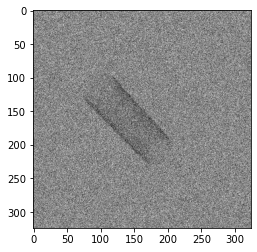

Predicted image:


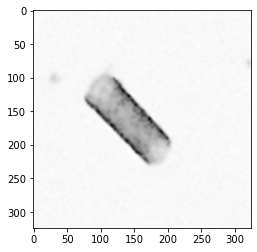

Ground truth:


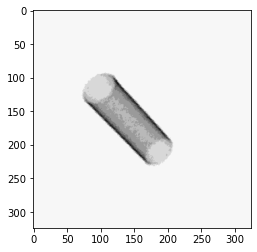

 37%|███▋      | 1100/3000 [2:42:30<5:31:44, 10.48s/it]

Epoch [1/1], Step [1101/3000], Loss: 0.0002096793
Original image:


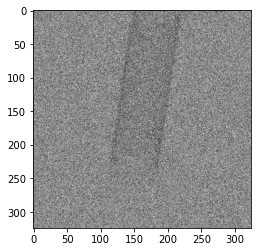

Predicted image:


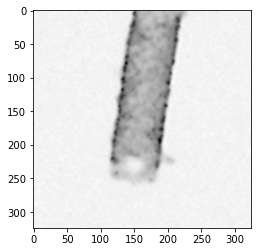

Ground truth:


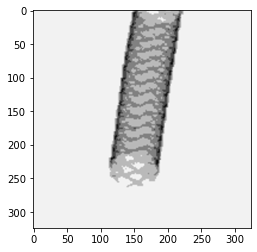

 37%|███▋      | 1110/3000 [2:44:18<5:37:02, 10.70s/it]

Epoch [1/1], Step [1111/3000], Loss: 0.0001259122
Original image:


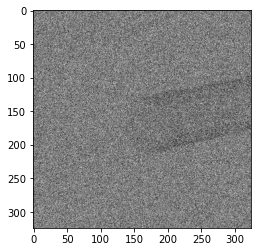

Predicted image:


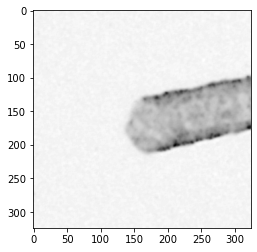

Ground truth:


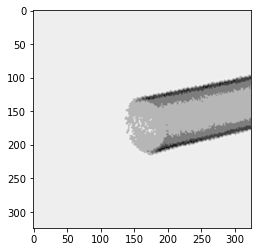

 37%|███▋      | 1120/3000 [2:46:09<6:00:29, 11.51s/it]

Epoch [1/1], Step [1121/3000], Loss: 0.0002193775
Original image:


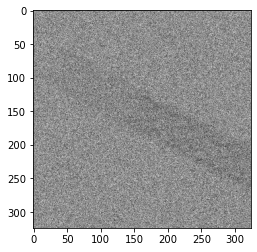

Predicted image:


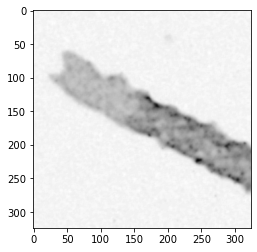

Ground truth:


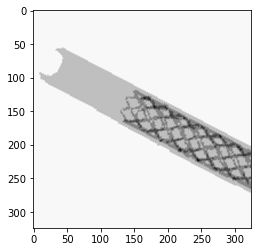

 38%|███▊      | 1130/3000 [2:47:55<5:41:45, 10.97s/it]

Epoch [1/1], Step [1131/3000], Loss: 0.0001134172
Original image:


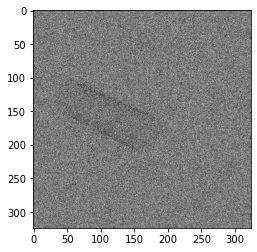

Predicted image:


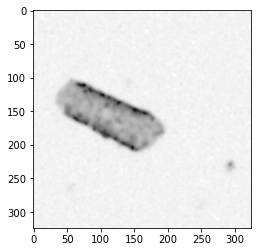

Ground truth:


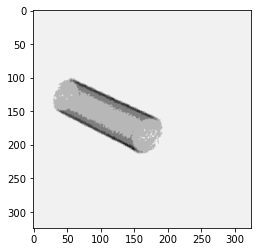

 38%|███▊      | 1140/3000 [2:49:41<5:48:47, 11.25s/it]

Epoch [1/1], Step [1141/3000], Loss: 0.0001128983
Original image:


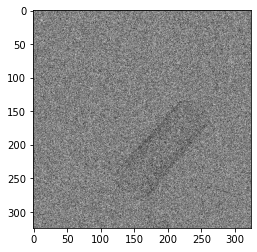

Predicted image:


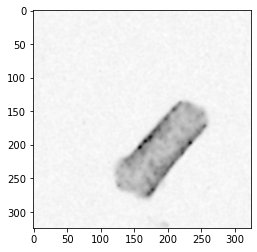

Ground truth:


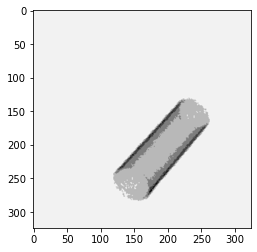

 38%|███▊      | 1150/3000 [2:51:29<5:21:05, 10.41s/it]

Epoch [1/1], Step [1151/3000], Loss: 0.0000671669
Original image:


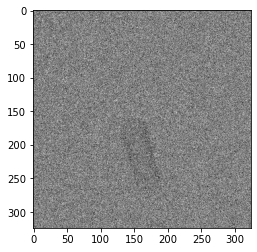

Predicted image:


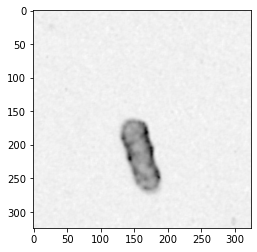

Ground truth:


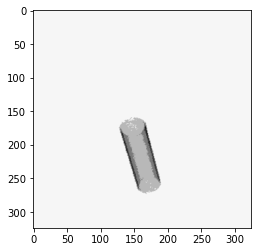

 39%|███▊      | 1160/3000 [2:53:16<5:17:38, 10.36s/it]

Epoch [1/1], Step [1161/3000], Loss: 0.0002459050
Original image:


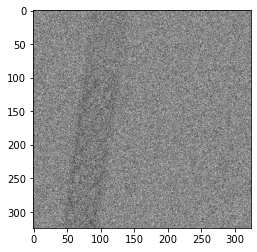

Predicted image:


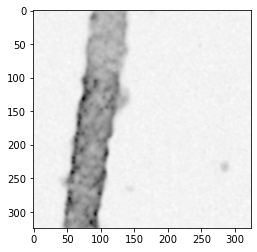

Ground truth:


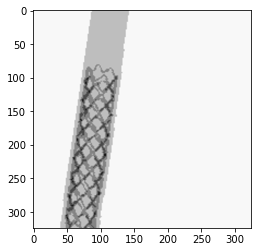

 39%|███▉      | 1170/3000 [2:55:01<5:07:28, 10.08s/it]

Epoch [1/1], Step [1171/3000], Loss: 0.0000637896
Original image:


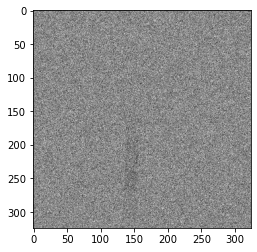

Predicted image:


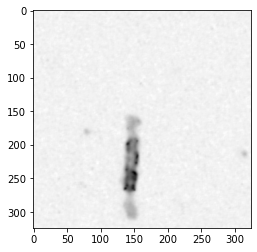

Ground truth:


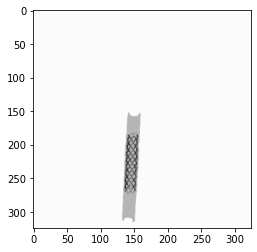

 39%|███▉      | 1180/3000 [2:56:47<5:30:49, 10.91s/it]

Epoch [1/1], Step [1181/3000], Loss: 0.0000747401
Original image:


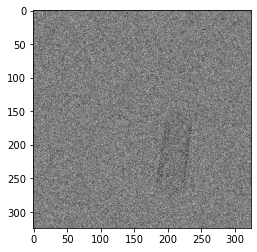

Predicted image:


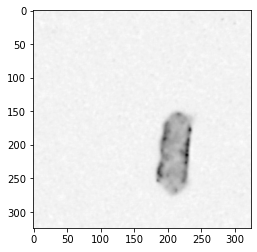

Ground truth:


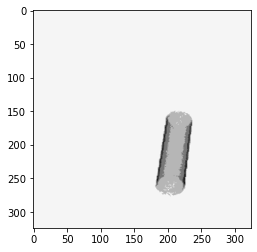

 40%|███▉      | 1190/3000 [2:58:35<5:32:28, 11.02s/it]

Epoch [1/1], Step [1191/3000], Loss: 0.0003159869
Original image:


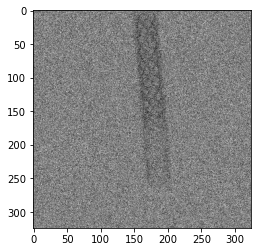

Predicted image:


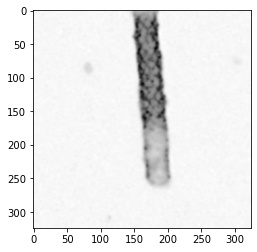

Ground truth:


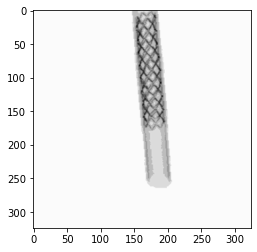

 40%|████      | 1200/3000 [3:00:22<5:30:26, 11.01s/it]

Epoch [1/1], Step [1201/3000], Loss: 0.0001613457
Original image:


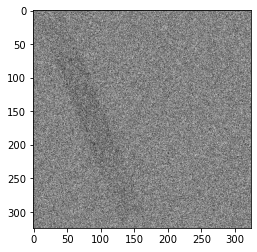

Predicted image:


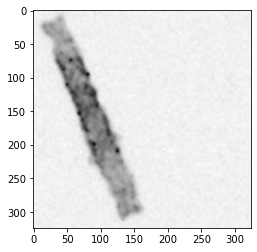

Ground truth:


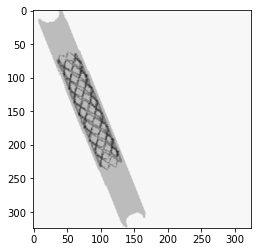

 40%|████      | 1210/3000 [3:02:11<5:24:25, 10.87s/it]

Epoch [1/1], Step [1211/3000], Loss: 0.0001356184
Original image:


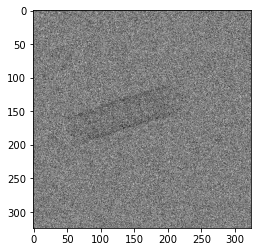

Predicted image:


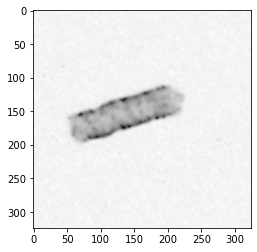

Ground truth:


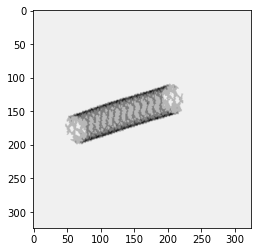

 41%|████      | 1220/3000 [3:03:57<5:07:41, 10.37s/it]

Epoch [1/1], Step [1221/3000], Loss: 0.0002069958
Original image:


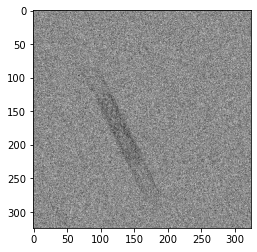

Predicted image:


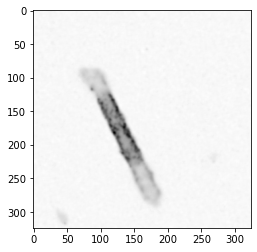

Ground truth:


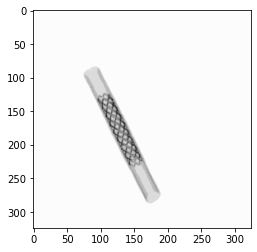

 41%|████      | 1230/3000 [3:05:42<5:01:58, 10.24s/it]

Epoch [1/1], Step [1231/3000], Loss: 0.0001270933
Original image:


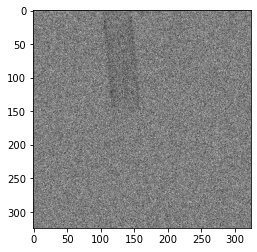

Predicted image:


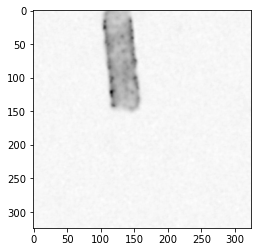

Ground truth:


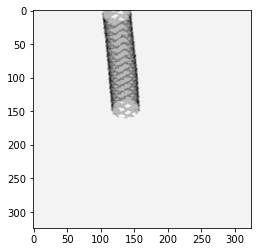

 41%|████▏     | 1240/3000 [3:07:17<4:25:20,  9.05s/it]

Epoch [1/1], Step [1241/3000], Loss: 0.0001193962
Original image:


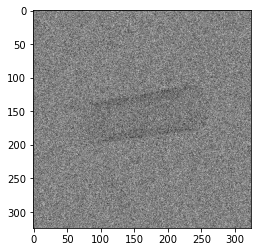

Predicted image:


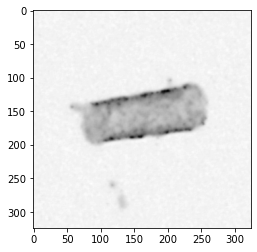

Ground truth:


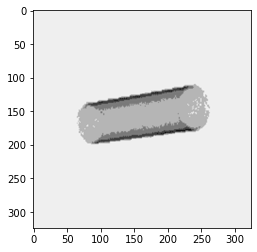

 42%|████▏     | 1250/3000 [3:08:44<4:06:02,  8.44s/it]

Epoch [1/1], Step [1251/3000], Loss: 0.0001407757
Original image:


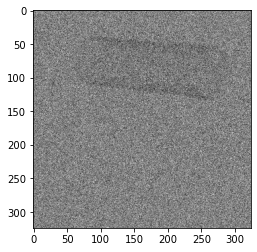

Predicted image:


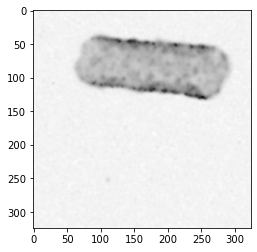

Ground truth:


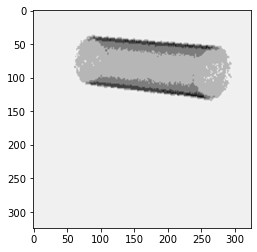

 42%|████▏     | 1260/3000 [3:10:11<4:06:59,  8.52s/it]

Epoch [1/1], Step [1261/3000], Loss: 0.0000697579
Original image:


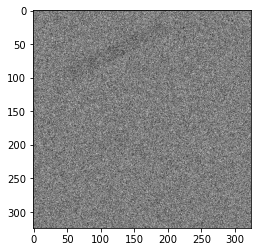

Predicted image:


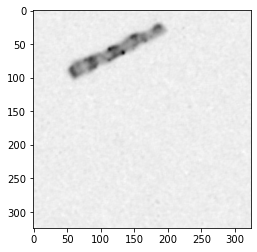

Ground truth:


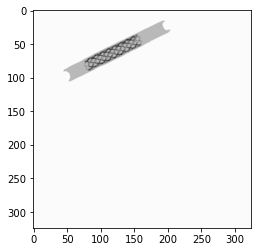

 42%|████▏     | 1270/3000 [3:11:37<4:12:26,  8.76s/it]

Epoch [1/1], Step [1271/3000], Loss: 0.0001552410
Original image:


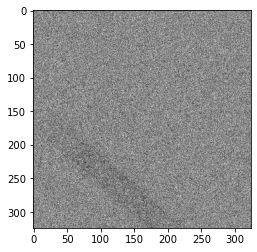

Predicted image:


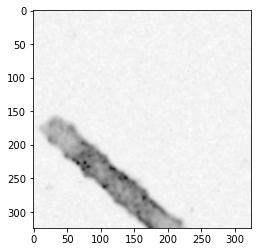

Ground truth:


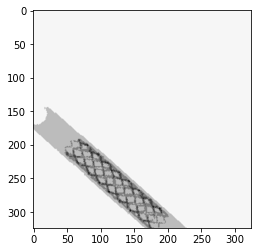

 43%|████▎     | 1280/3000 [3:13:06<4:18:27,  9.02s/it]

Epoch [1/1], Step [1281/3000], Loss: 0.0001159632
Original image:


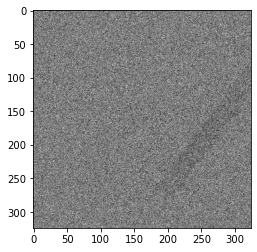

Predicted image:


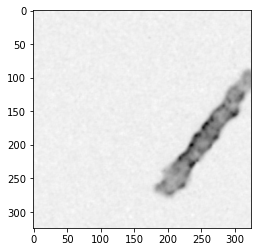

Ground truth:


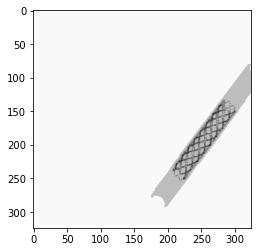

 43%|████▎     | 1290/3000 [3:14:31<3:56:22,  8.29s/it]

Epoch [1/1], Step [1291/3000], Loss: 0.0005064869
Original image:


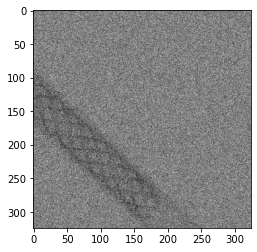

Predicted image:


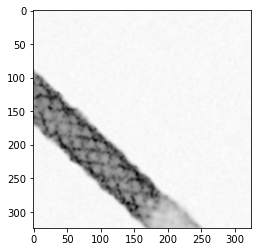

Ground truth:


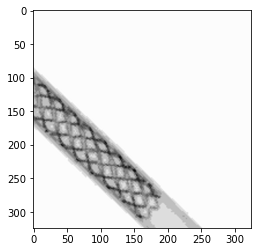

 43%|████▎     | 1300/3000 [3:15:58<3:59:51,  8.47s/it]

Epoch [1/1], Step [1301/3000], Loss: 0.0000856962
Original image:


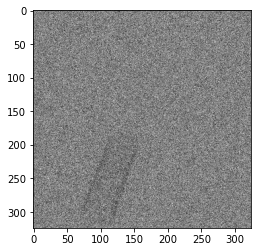

Predicted image:


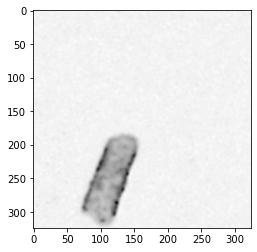

Ground truth:


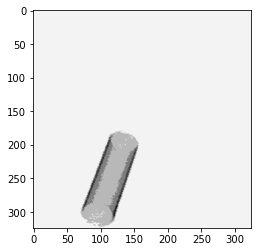

 44%|████▎     | 1310/3000 [3:17:24<4:13:00,  8.98s/it]

Epoch [1/1], Step [1311/3000], Loss: 0.0001682169
Original image:


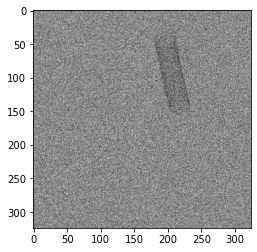

Predicted image:


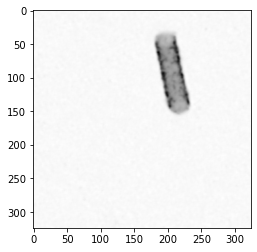

Ground truth:


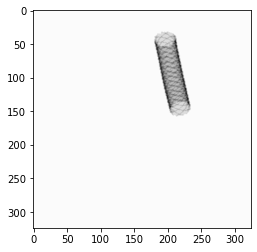

 44%|████▍     | 1320/3000 [3:18:50<3:55:11,  8.40s/it]

Epoch [1/1], Step [1321/3000], Loss: 0.0001301639
Original image:


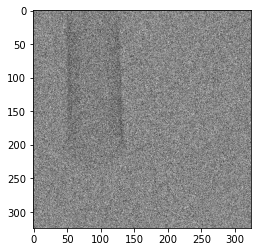

Predicted image:


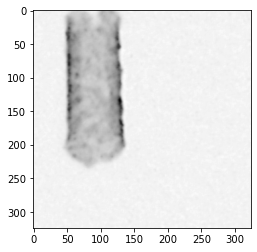

Ground truth:


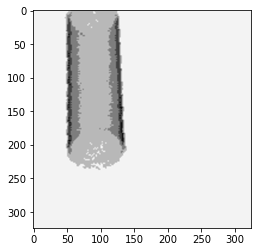

 44%|████▍     | 1330/3000 [3:20:17<4:12:27,  9.07s/it]

Epoch [1/1], Step [1331/3000], Loss: 0.0002483723
Original image:


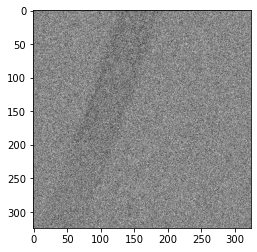

Predicted image:


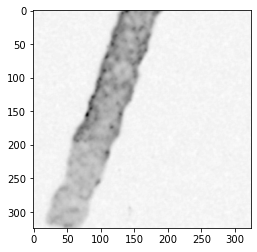

Ground truth:


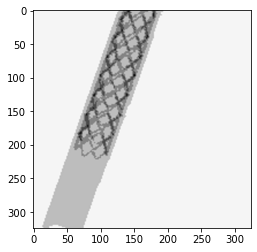

 45%|████▍     | 1340/3000 [3:21:44<4:01:43,  8.74s/it]

Epoch [1/1], Step [1341/3000], Loss: 0.0003575882
Original image:


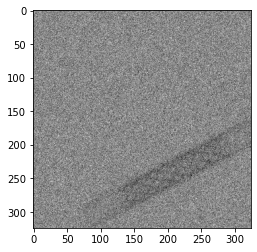

Predicted image:


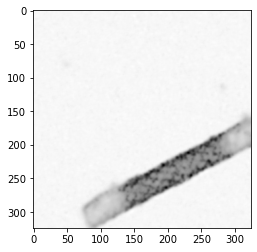

Ground truth:


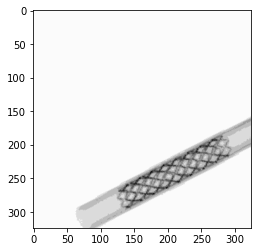

 45%|████▌     | 1350/3000 [3:23:10<3:49:54,  8.36s/it]

Epoch [1/1], Step [1351/3000], Loss: 0.0002078354
Original image:


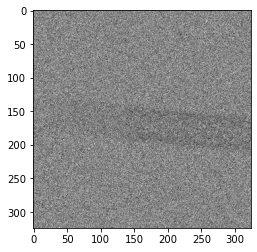

Predicted image:


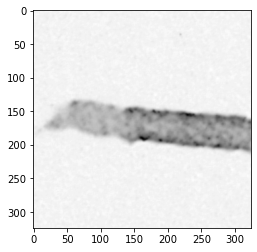

Ground truth:


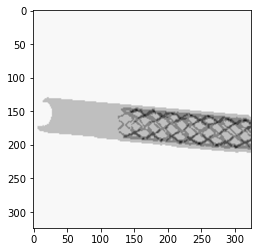

 45%|████▌     | 1360/3000 [3:24:34<3:45:57,  8.27s/it]

Epoch [1/1], Step [1361/3000], Loss: 0.0001289047
Original image:


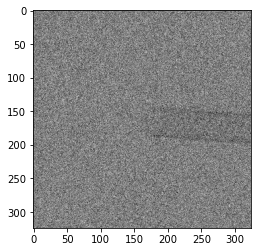

Predicted image:


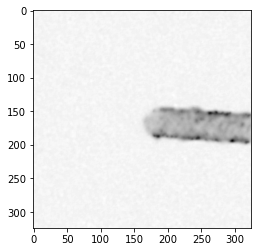

Ground truth:


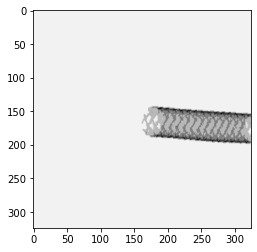

 46%|████▌     | 1370/3000 [3:26:00<3:49:41,  8.45s/it]

Epoch [1/1], Step [1371/3000], Loss: 0.0000798007
Original image:


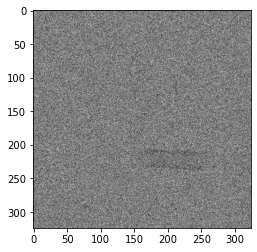

Predicted image:


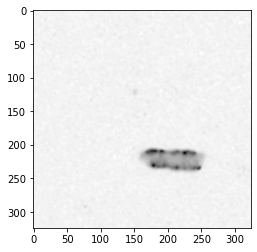

Ground truth:


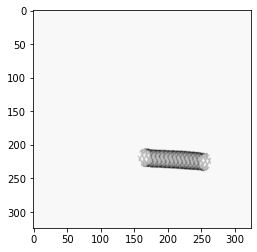

 46%|████▌     | 1380/3000 [3:27:23<3:42:10,  8.23s/it]

Epoch [1/1], Step [1381/3000], Loss: 0.0001628131
Original image:


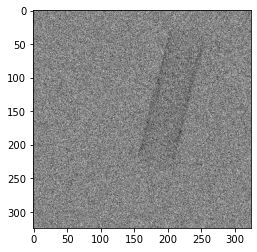

Predicted image:


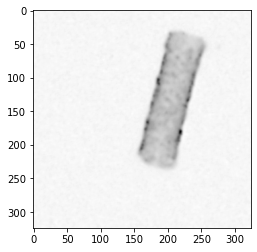

Ground truth:


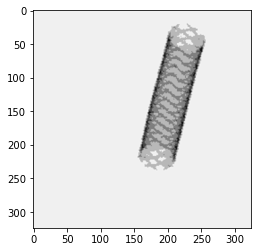

 46%|████▋     | 1390/3000 [3:28:46<3:38:26,  8.14s/it]

Epoch [1/1], Step [1391/3000], Loss: 0.0001239159
Original image:


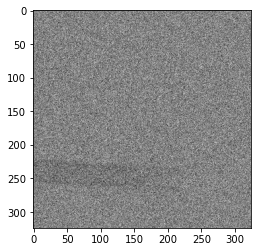

Predicted image:


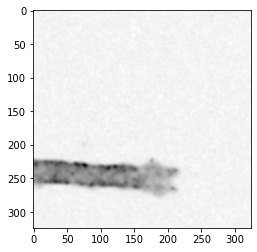

Ground truth:


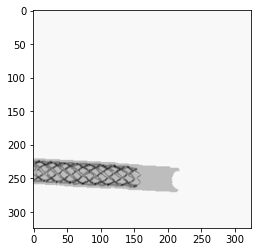

 47%|████▋     | 1400/3000 [3:30:15<3:57:36,  8.91s/it]

Epoch [1/1], Step [1401/3000], Loss: 0.0001084622
Original image:


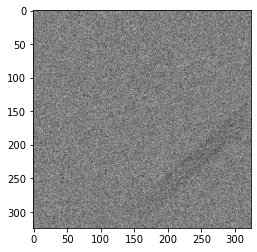

Predicted image:


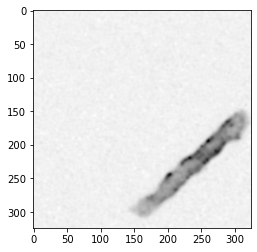

Ground truth:


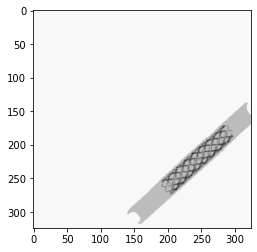

 47%|████▋     | 1410/3000 [3:31:40<3:42:59,  8.41s/it]

Epoch [1/1], Step [1411/3000], Loss: 0.0000685574
Original image:


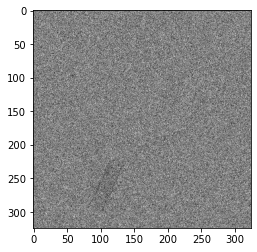

Predicted image:


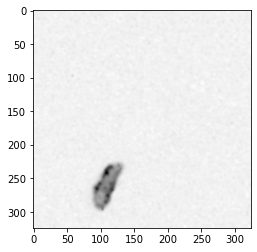

Ground truth:


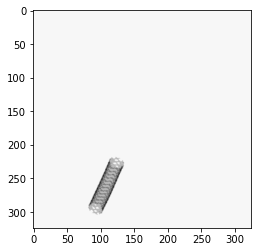

 47%|████▋     | 1420/3000 [3:33:05<3:43:02,  8.47s/it]

Epoch [1/1], Step [1421/3000], Loss: 0.0000857677
Original image:


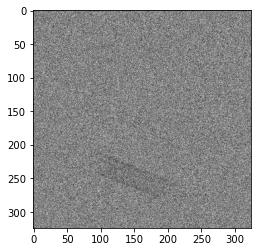

Predicted image:


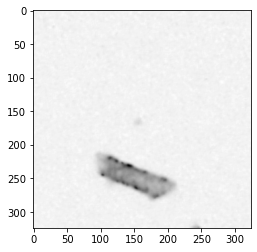

Ground truth:


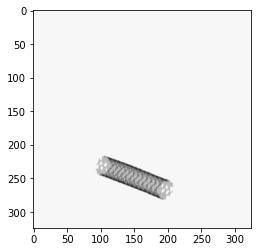

 48%|████▊     | 1430/3000 [3:34:31<3:48:27,  8.73s/it]

Epoch [1/1], Step [1431/3000], Loss: 0.0001447592
Original image:


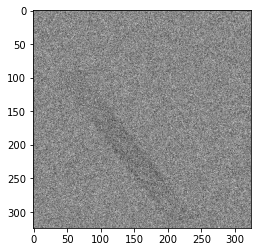

Predicted image:


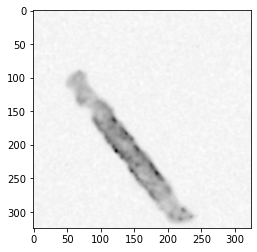

Ground truth:


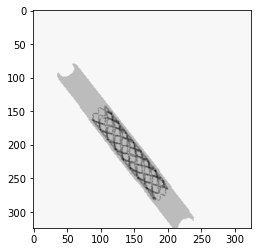

 48%|████▊     | 1440/3000 [3:35:56<3:45:03,  8.66s/it]

Epoch [1/1], Step [1441/3000], Loss: 0.0002743104
Original image:


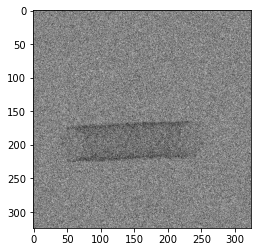

Predicted image:


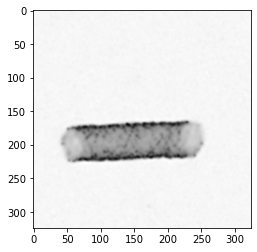

Ground truth:


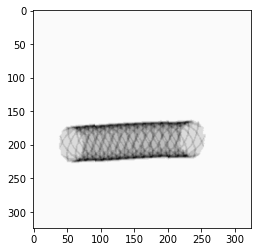

 48%|████▊     | 1450/3000 [3:37:19<3:37:00,  8.40s/it]

Epoch [1/1], Step [1451/3000], Loss: 0.0004232524
Original image:


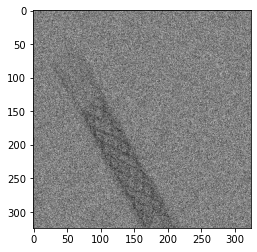

Predicted image:


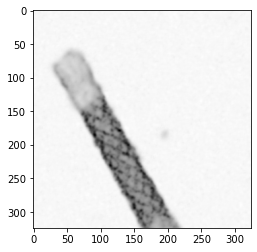

Ground truth:


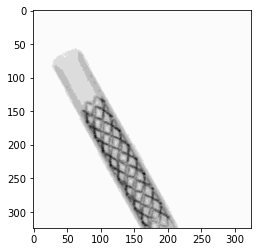

 49%|████▊     | 1460/3000 [3:38:43<3:38:44,  8.52s/it]

Epoch [1/1], Step [1461/3000], Loss: 0.0001050116
Original image:


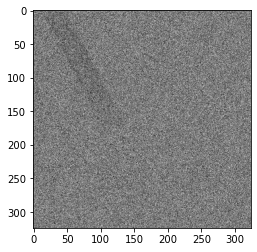

Predicted image:


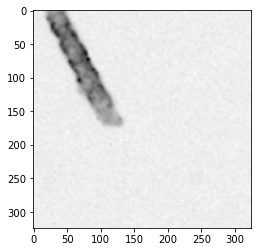

Ground truth:


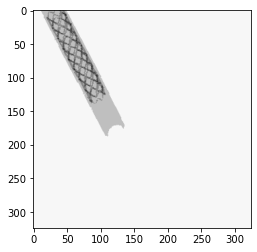

 49%|████▉     | 1470/3000 [3:40:06<3:32:23,  8.33s/it]

Epoch [1/1], Step [1471/3000], Loss: 0.0000912557
Original image:


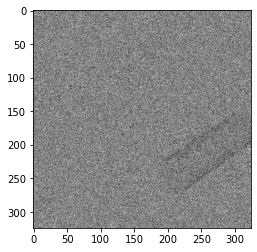

Predicted image:


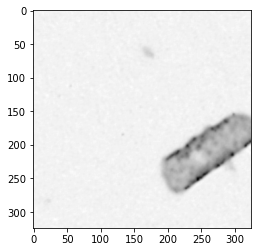

Ground truth:


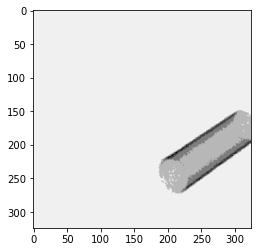

 49%|████▉     | 1480/3000 [3:41:30<3:32:21,  8.38s/it]

Epoch [1/1], Step [1481/3000], Loss: 0.0001147281
Original image:


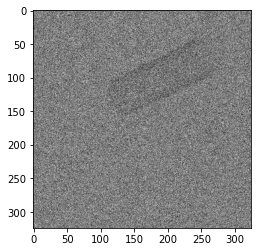

Predicted image:


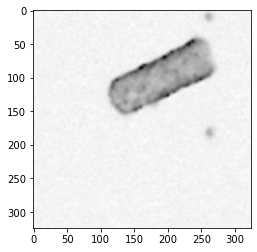

Ground truth:


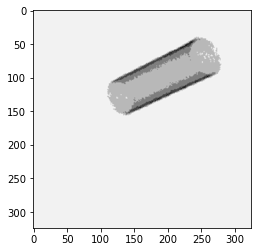

 50%|████▉     | 1490/3000 [3:42:55<3:33:16,  8.47s/it]

Epoch [1/1], Step [1491/3000], Loss: 0.0001181662
Original image:


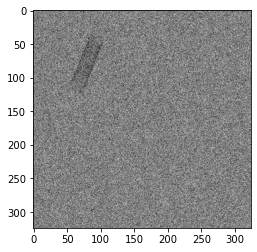

Predicted image:


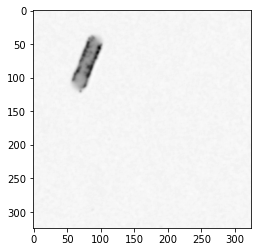

Ground truth:


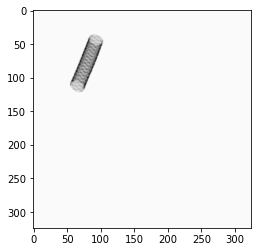

 50%|█████     | 1500/3000 [3:44:21<3:35:24,  8.62s/it]

Epoch [1/1], Step [1501/3000], Loss: 0.0001356418
Original image:


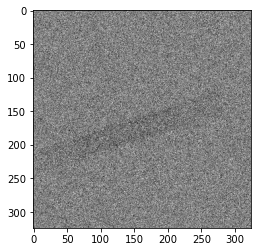

Predicted image:


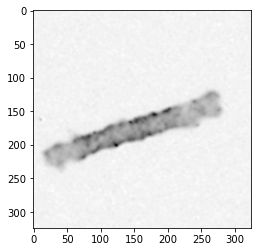

Ground truth:


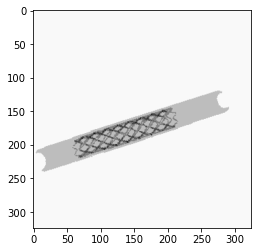

 50%|█████     | 1510/3000 [3:45:46<3:31:15,  8.51s/it]

Epoch [1/1], Step [1511/3000], Loss: 0.0001527738
Original image:


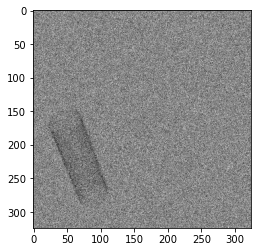

Predicted image:


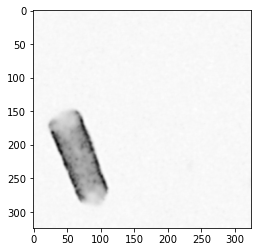

Ground truth:


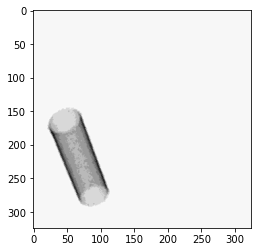

 51%|█████     | 1520/3000 [3:47:11<3:27:15,  8.40s/it]

Epoch [1/1], Step [1521/3000], Loss: 0.0000705536
Original image:


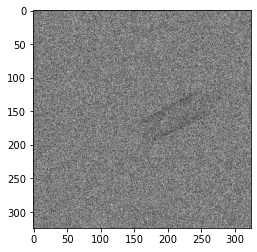

Predicted image:


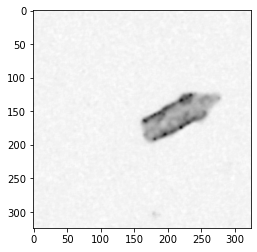

Ground truth:


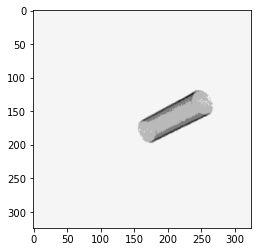

 51%|█████     | 1530/3000 [3:48:35<3:21:34,  8.23s/it]

Epoch [1/1], Step [1531/3000], Loss: 0.0001489301
Original image:


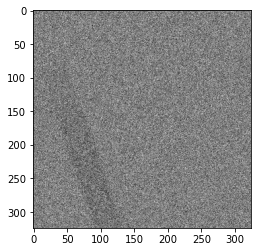

Predicted image:


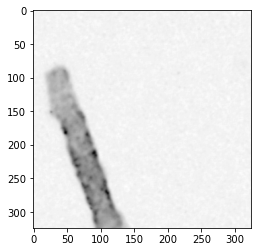

Ground truth:


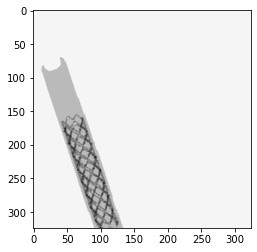

 51%|█████▏    | 1540/3000 [3:49:59<3:21:24,  8.28s/it]

Epoch [1/1], Step [1541/3000], Loss: 0.0001031285
Original image:


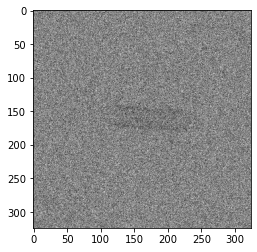

Predicted image:


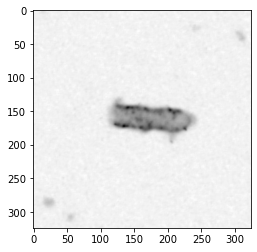

Ground truth:


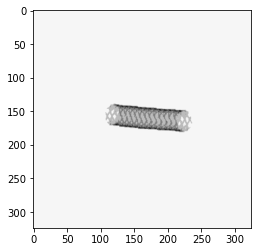

 52%|█████▏    | 1550/3000 [3:51:23<3:20:24,  8.29s/it]

Epoch [1/1], Step [1551/3000], Loss: 0.0001091600
Original image:


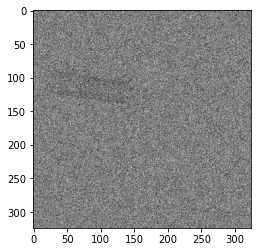

Predicted image:


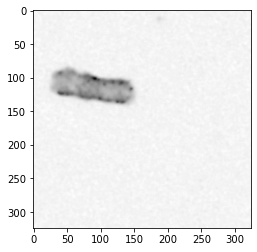

Ground truth:


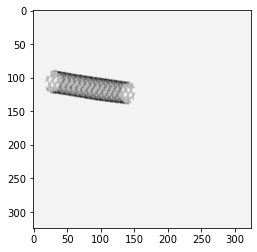

 52%|█████▏    | 1560/3000 [3:52:48<3:20:05,  8.34s/it]

Epoch [1/1], Step [1561/3000], Loss: 0.0001193468
Original image:


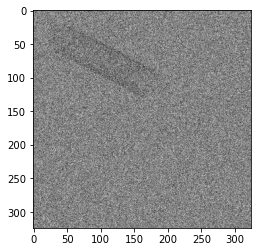

Predicted image:


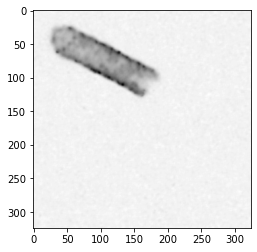

Ground truth:


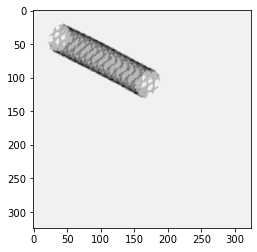

 52%|█████▏    | 1570/3000 [3:54:12<3:16:33,  8.25s/it]

Epoch [1/1], Step [1571/3000], Loss: 0.0000680595
Original image:


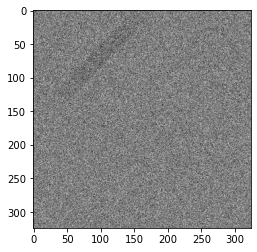

Predicted image:


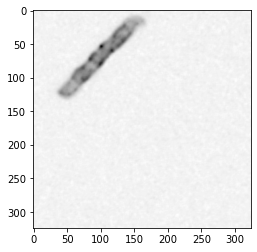

Ground truth:


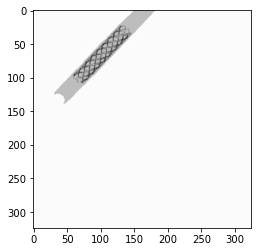

 53%|█████▎    | 1580/3000 [3:55:36<3:16:16,  8.29s/it]

Epoch [1/1], Step [1581/3000], Loss: 0.0001323976
Original image:


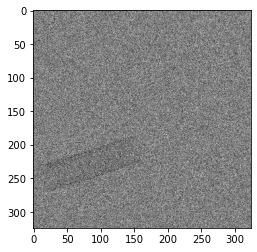

Predicted image:


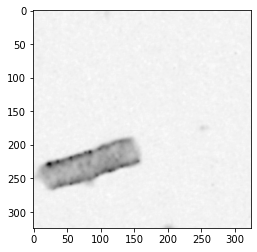

Ground truth:


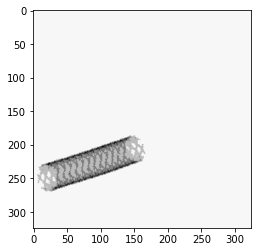

 53%|█████▎    | 1590/3000 [3:57:00<3:14:30,  8.28s/it]

Epoch [1/1], Step [1591/3000], Loss: 0.0001087732
Original image:


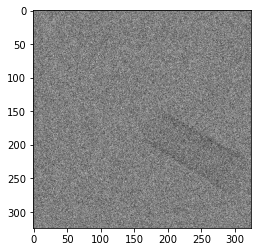

Predicted image:


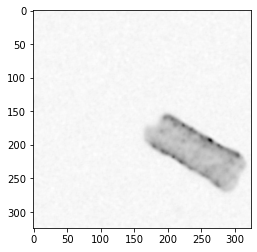

Ground truth:


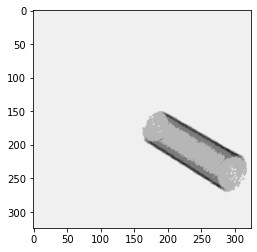

 53%|█████▎    | 1600/3000 [3:58:25<3:13:09,  8.28s/it]

Epoch [1/1], Step [1601/3000], Loss: 0.0000980150
Original image:


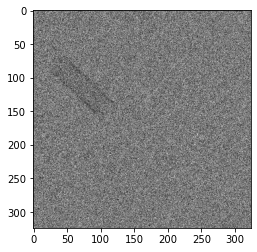

Predicted image:


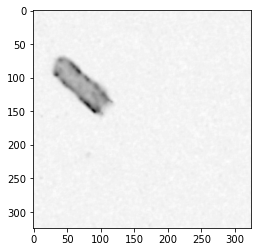

Ground truth:


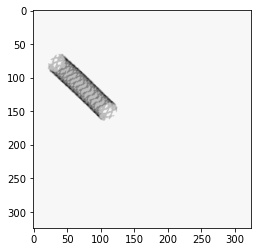

 54%|█████▎    | 1610/3000 [3:59:50<3:12:24,  8.31s/it]

Epoch [1/1], Step [1611/3000], Loss: 0.0002054909
Original image:


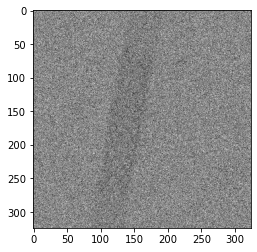

Predicted image:


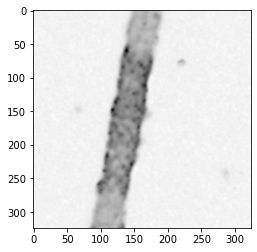

Ground truth:


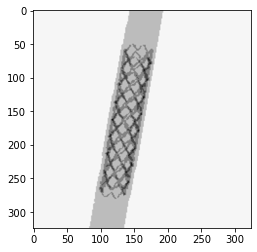

 54%|█████▍    | 1620/3000 [4:01:14<3:09:54,  8.26s/it]

Epoch [1/1], Step [1621/3000], Loss: 0.0001258971
Original image:


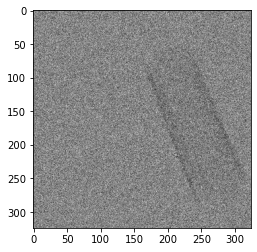

Predicted image:


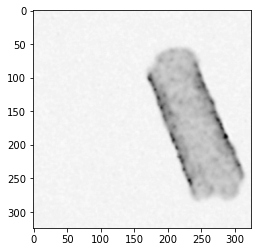

Ground truth:


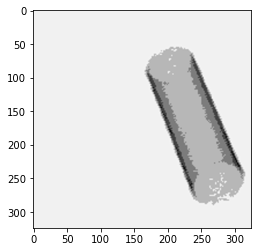

 54%|█████▍    | 1630/3000 [4:02:39<3:09:53,  8.32s/it]

Epoch [1/1], Step [1631/3000], Loss: 0.0001951701
Original image:


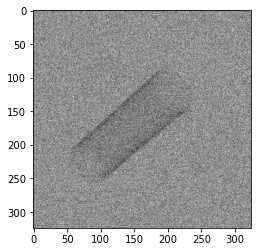

Predicted image:


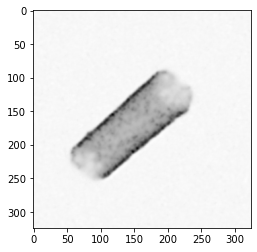

Ground truth:


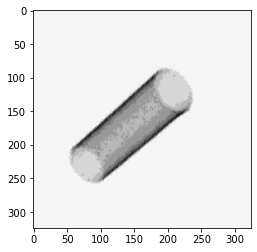

 55%|█████▍    | 1640/3000 [4:04:03<3:09:44,  8.37s/it]

Epoch [1/1], Step [1641/3000], Loss: 0.0000865212
Original image:


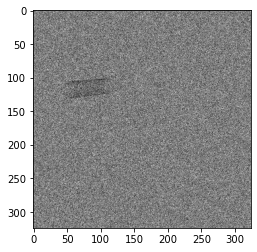

Predicted image:


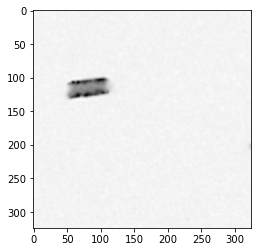

Ground truth:


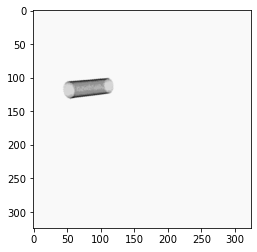

 55%|█████▌    | 1650/3000 [4:05:27<3:06:11,  8.27s/it]

Epoch [1/1], Step [1651/3000], Loss: 0.0001123961
Original image:


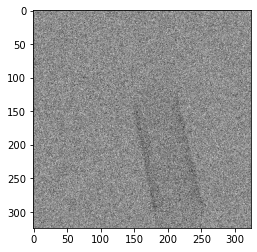

Predicted image:


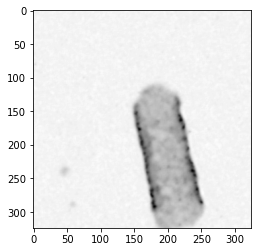

Ground truth:


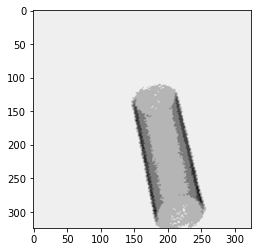

 55%|█████▌    | 1660/3000 [4:06:54<3:07:10,  8.38s/it]

Epoch [1/1], Step [1661/3000], Loss: 0.0000841417
Original image:


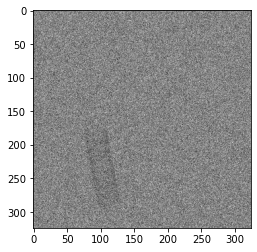

Predicted image:


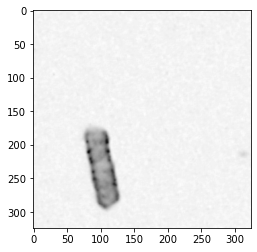

Ground truth:


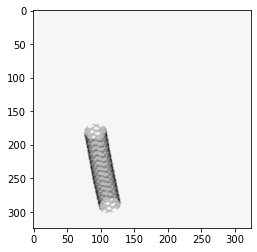

 56%|█████▌    | 1670/3000 [4:08:19<3:05:23,  8.36s/it]

Epoch [1/1], Step [1671/3000], Loss: 0.0000481638
Original image:


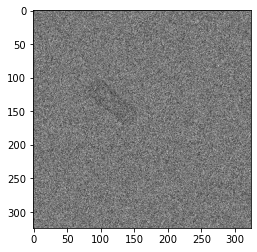

Predicted image:


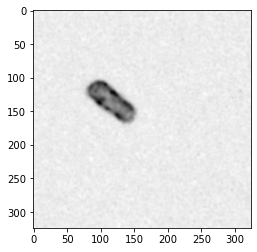

Ground truth:


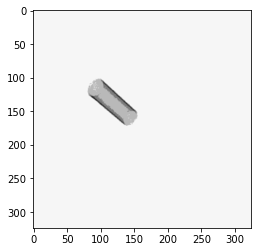

 56%|█████▌    | 1680/3000 [4:09:45<3:06:36,  8.48s/it]

Epoch [1/1], Step [1681/3000], Loss: 0.0000499027
Original image:


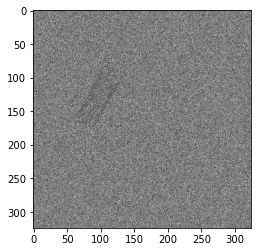

Predicted image:


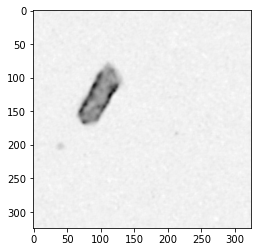

Ground truth:


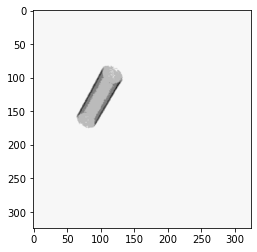

 56%|█████▋    | 1690/3000 [4:11:13<3:19:01,  9.12s/it]

Epoch [1/1], Step [1691/3000], Loss: 0.0001514991
Original image:


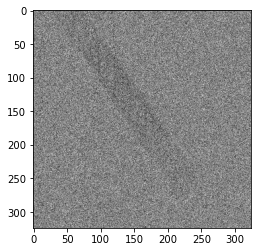

Predicted image:


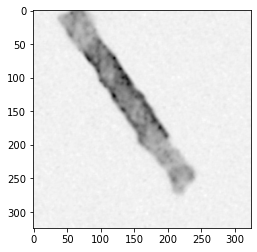

Ground truth:


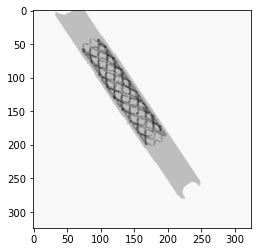

 57%|█████▋    | 1700/3000 [4:12:40<3:09:50,  8.76s/it]

Epoch [1/1], Step [1701/3000], Loss: 0.0000826281
Original image:


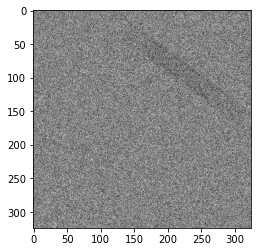

Predicted image:


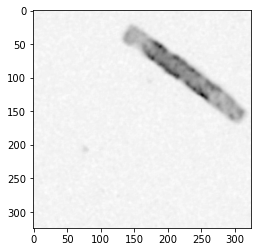

Ground truth:


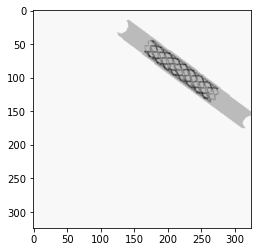

 57%|█████▋    | 1710/3000 [4:14:08<3:10:07,  8.84s/it]

Epoch [1/1], Step [1711/3000], Loss: 0.0000984345
Original image:


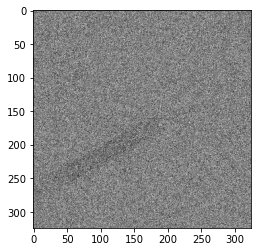

Predicted image:


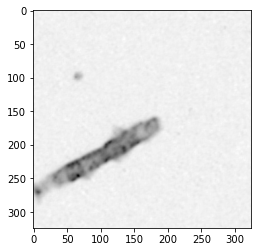

Ground truth:


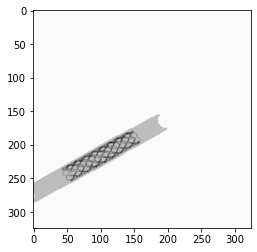

 57%|█████▋    | 1720/3000 [4:15:33<3:03:54,  8.62s/it]

Epoch [1/1], Step [1721/3000], Loss: 0.0000596939
Original image:


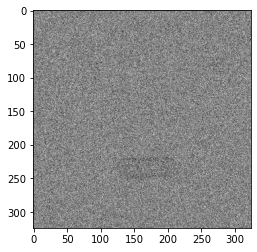

Predicted image:


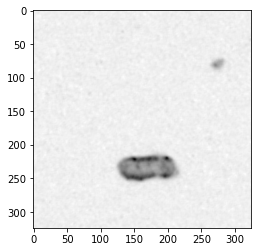

Ground truth:


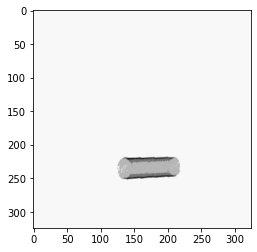

 58%|█████▊    | 1730/3000 [4:16:58<3:01:42,  8.58s/it]

Epoch [1/1], Step [1731/3000], Loss: 0.0001003394
Original image:


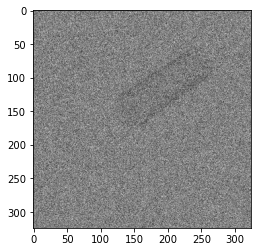

Predicted image:


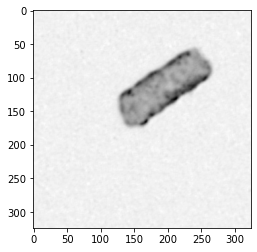

Ground truth:


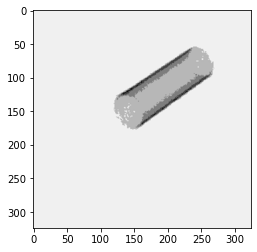

 58%|█████▊    | 1740/3000 [4:18:23<3:00:43,  8.61s/it]

Epoch [1/1], Step [1741/3000], Loss: 0.0000768124
Original image:


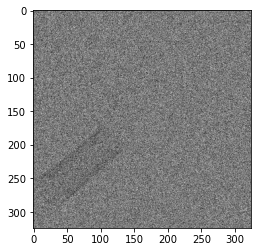

Predicted image:


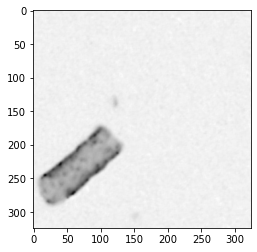

Ground truth:


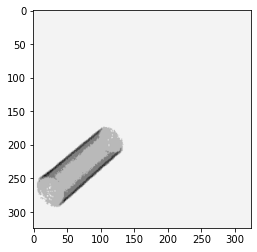

 58%|█████▊    | 1750/3000 [4:19:50<3:03:05,  8.79s/it]

Epoch [1/1], Step [1751/3000], Loss: 0.0002938269
Original image:


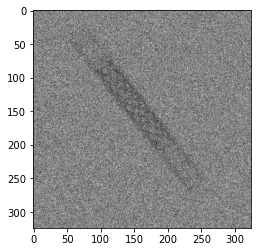

Predicted image:


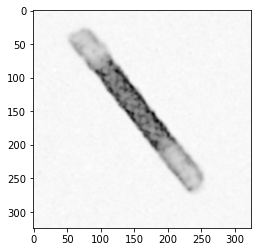

Ground truth:


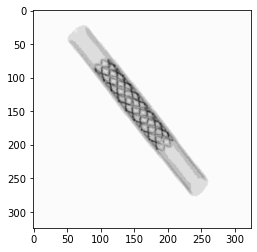

 59%|█████▊    | 1760/3000 [4:21:17<2:55:27,  8.49s/it]

Epoch [1/1], Step [1761/3000], Loss: 0.0001195269
Original image:


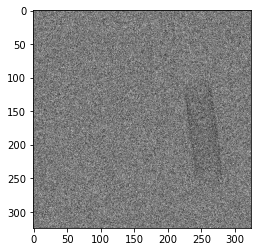

Predicted image:


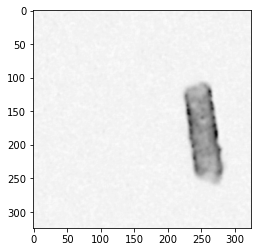

Ground truth:


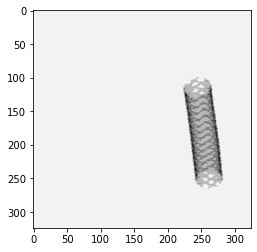

 59%|█████▉    | 1770/3000 [4:22:43<2:51:00,  8.34s/it]

Epoch [1/1], Step [1771/3000], Loss: 0.0000514322
Original image:


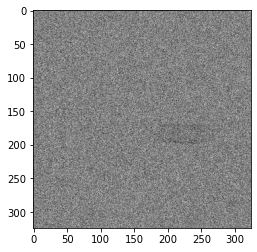

Predicted image:


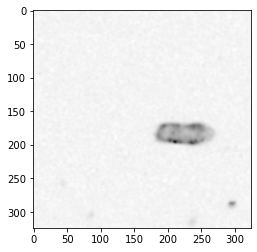

Ground truth:


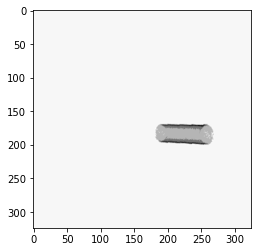

 59%|█████▉    | 1780/3000 [4:24:08<2:51:59,  8.46s/it]

Epoch [1/1], Step [1781/3000], Loss: 0.0002797513
Original image:


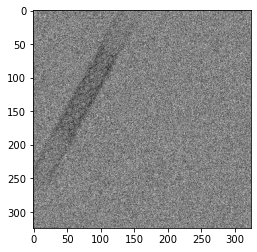

Predicted image:


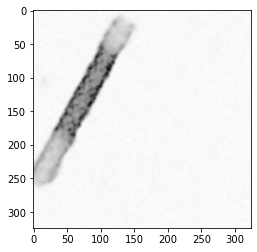

Ground truth:


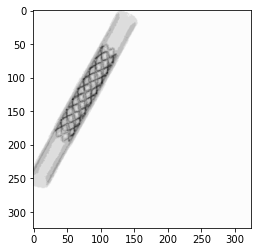

 60%|█████▉    | 1790/3000 [4:25:36<2:54:29,  8.65s/it]

Epoch [1/1], Step [1791/3000], Loss: 0.0002306187
Original image:


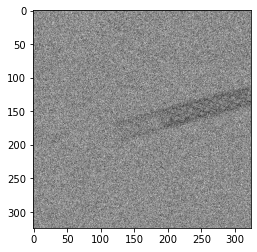

Predicted image:


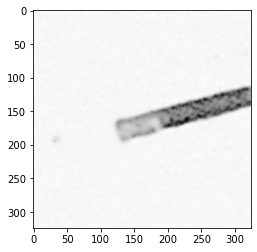

Ground truth:


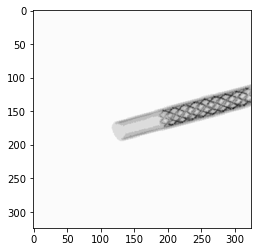

 60%|██████    | 1800/3000 [4:27:02<2:49:21,  8.47s/it]

Epoch [1/1], Step [1801/3000], Loss: 0.0000741473
Original image:


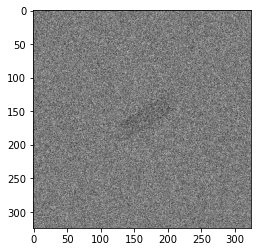

Predicted image:


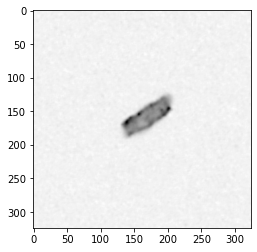

Ground truth:


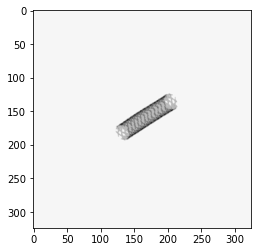

 60%|██████    | 1810/3000 [4:28:28<2:49:53,  8.57s/it]

Epoch [1/1], Step [1811/3000], Loss: 0.0000511249
Original image:


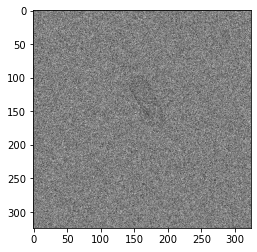

Predicted image:


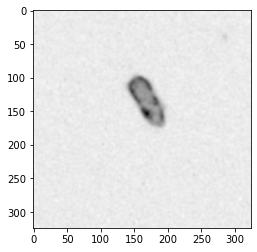

Ground truth:


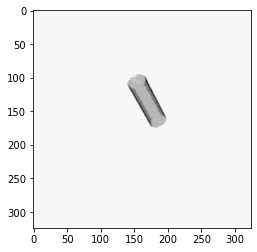

 61%|██████    | 1820/3000 [4:29:57<2:57:17,  9.01s/it]

Epoch [1/1], Step [1821/3000], Loss: 0.0000936622
Original image:


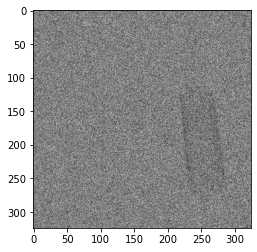

Predicted image:


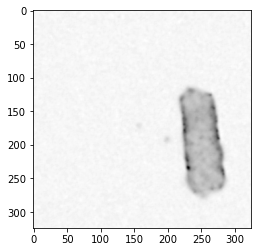

Ground truth:


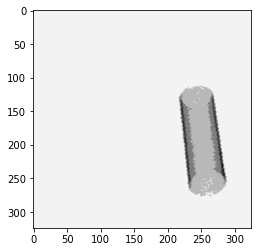

 61%|██████    | 1830/3000 [4:31:25<2:54:40,  8.96s/it]

Epoch [1/1], Step [1831/3000], Loss: 0.0001297417
Original image:


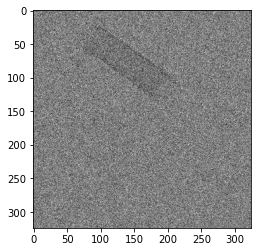

Predicted image:


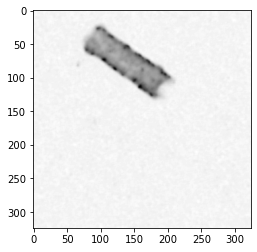

Ground truth:


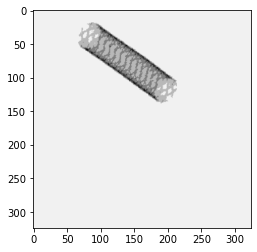

 61%|██████▏   | 1840/3000 [4:32:55<2:56:58,  9.15s/it]

Epoch [1/1], Step [1841/3000], Loss: 0.0001163087
Original image:


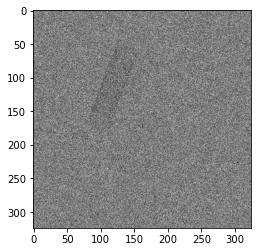

Predicted image:


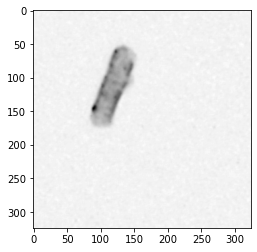

Ground truth:


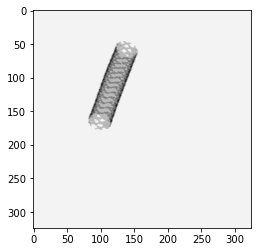

 62%|██████▏   | 1850/3000 [4:34:21<2:45:42,  8.65s/it]

Epoch [1/1], Step [1851/3000], Loss: 0.0005175711
Original image:


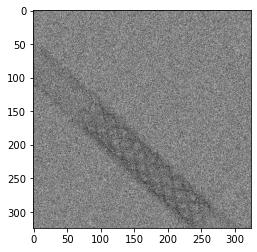

Predicted image:


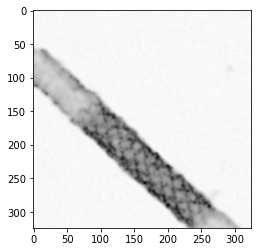

Ground truth:


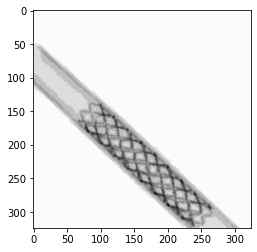

 62%|██████▏   | 1860/3000 [4:35:49<2:51:36,  9.03s/it]

Epoch [1/1], Step [1861/3000], Loss: 0.0000811328
Original image:


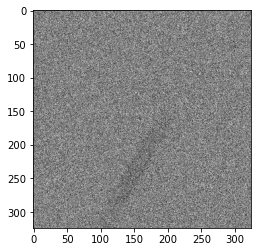

Predicted image:


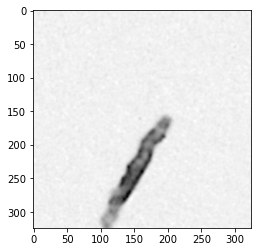

Ground truth:


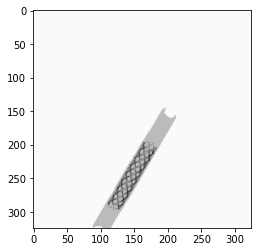

 62%|██████▏   | 1870/3000 [4:37:15<2:47:03,  8.87s/it]

Epoch [1/1], Step [1871/3000], Loss: 0.0002754384
Original image:


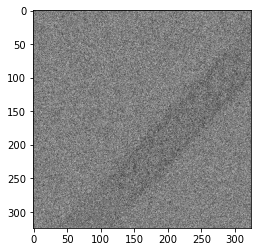

Predicted image:


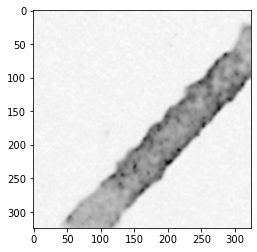

Ground truth:


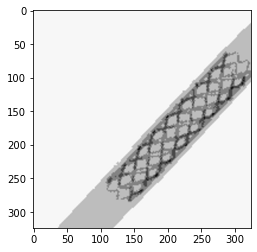

 63%|██████▎   | 1880/3000 [4:38:42<2:44:42,  8.82s/it]

Epoch [1/1], Step [1881/3000], Loss: 0.0000630690
Original image:


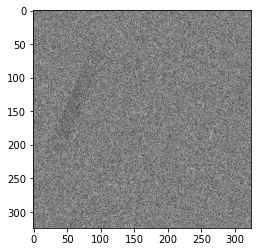

Predicted image:


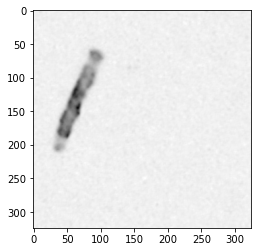

Ground truth:


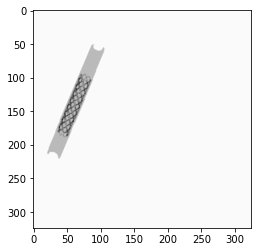

 63%|██████▎   | 1890/3000 [4:40:12<2:40:25,  8.67s/it]

Epoch [1/1], Step [1891/3000], Loss: 0.0001657571
Original image:


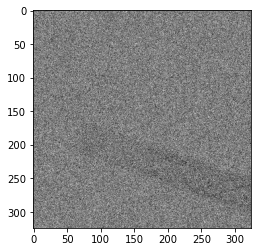

Predicted image:


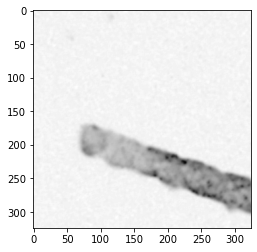

Ground truth:


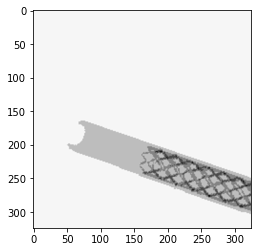

 63%|██████▎   | 1900/3000 [4:41:40<2:37:39,  8.60s/it]

Epoch [1/1], Step [1901/3000], Loss: 0.0001599107
Original image:


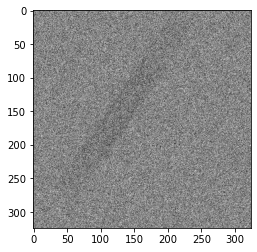

Predicted image:


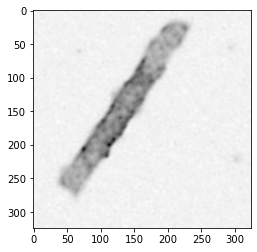

Ground truth:


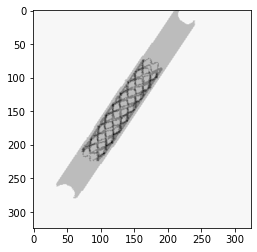

 64%|██████▎   | 1910/3000 [4:43:08<2:36:51,  8.63s/it]

Epoch [1/1], Step [1911/3000], Loss: 0.0001659216
Original image:


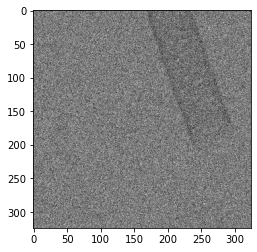

Predicted image:


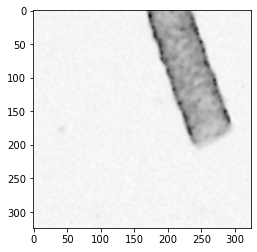

Ground truth:


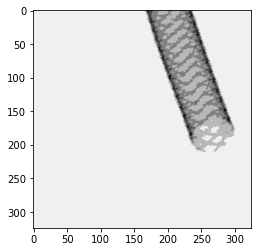

 64%|██████▍   | 1920/3000 [4:44:39<2:48:42,  9.37s/it]

Epoch [1/1], Step [1921/3000], Loss: 0.0001212280
Original image:


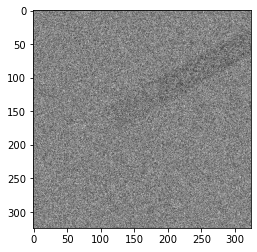

Predicted image:


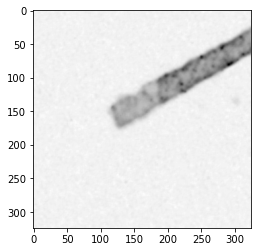

Ground truth:


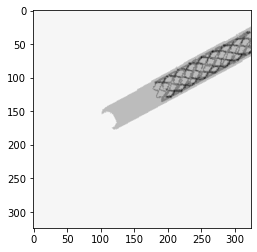

 64%|██████▍   | 1930/3000 [4:46:10<2:45:46,  9.30s/it]

Epoch [1/1], Step [1931/3000], Loss: 0.0001455424
Original image:


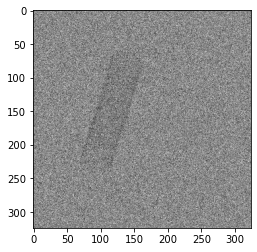

Predicted image:


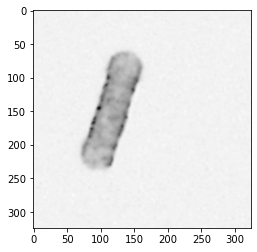

Ground truth:


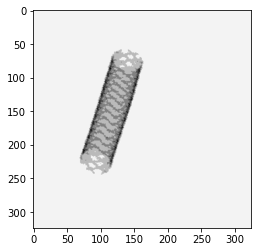

 65%|██████▍   | 1940/3000 [4:47:38<2:39:15,  9.01s/it]

Epoch [1/1], Step [1941/3000], Loss: 0.0001487388
Original image:


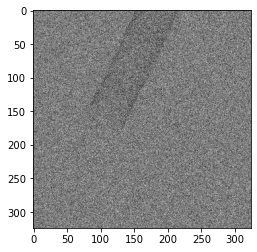

Predicted image:


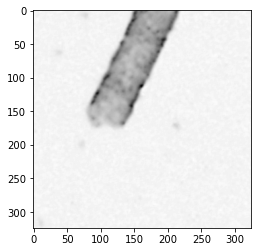

Ground truth:


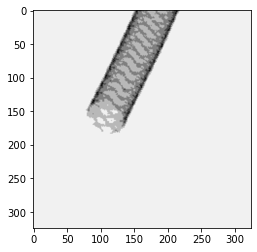

 65%|██████▌   | 1950/3000 [4:49:08<2:40:31,  9.17s/it]

Epoch [1/1], Step [1951/3000], Loss: 0.0000963424
Original image:


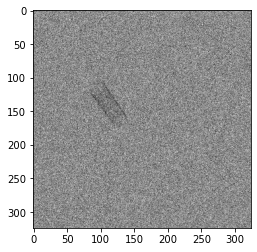

Predicted image:


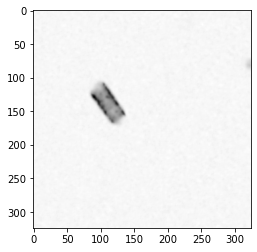

Ground truth:


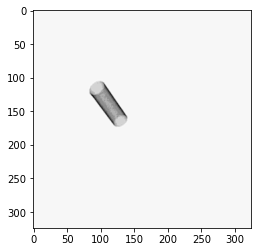

 65%|██████▌   | 1960/3000 [4:50:39<2:32:50,  8.82s/it]

Epoch [1/1], Step [1961/3000], Loss: 0.0000998685
Original image:


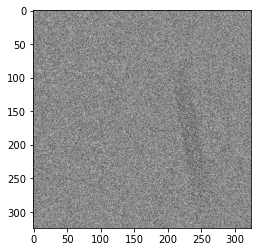

Predicted image:


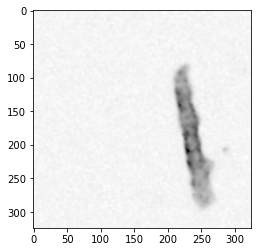

Ground truth:


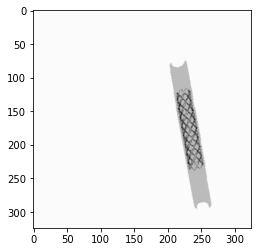

 66%|██████▌   | 1970/3000 [4:52:06<2:28:37,  8.66s/it]

Epoch [1/1], Step [1971/3000], Loss: 0.0001313903
Original image:


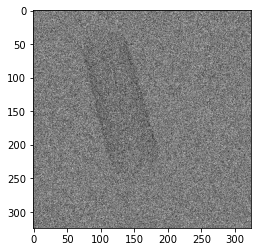

Predicted image:


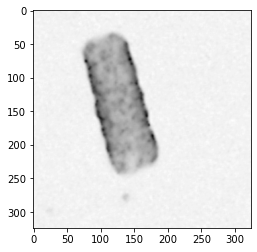

Ground truth:


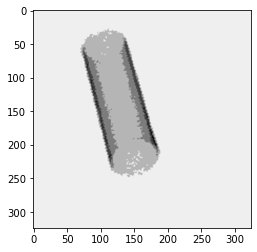

 66%|██████▌   | 1980/3000 [4:53:37<2:29:47,  8.81s/it]

Epoch [1/1], Step [1981/3000], Loss: 0.0000933449
Original image:


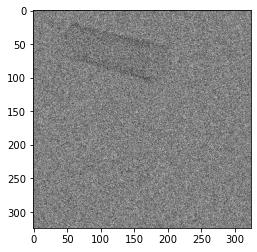

Predicted image:


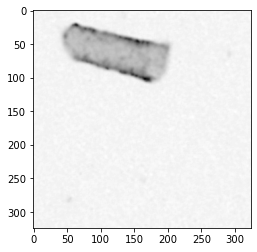

Ground truth:


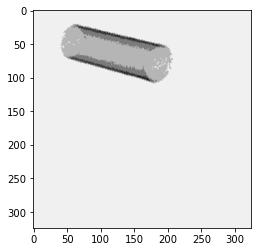

 66%|██████▋   | 1990/3000 [4:55:04<2:24:57,  8.61s/it]

Epoch [1/1], Step [1991/3000], Loss: 0.0001430575
Original image:


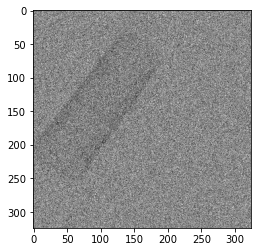

Predicted image:


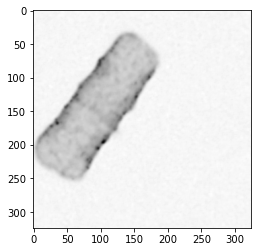

Ground truth:


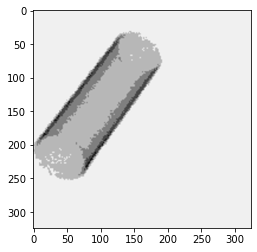

 67%|██████▋   | 2000/3000 [4:56:35<2:33:05,  9.19s/it]

Epoch [1/1], Step [2001/3000], Loss: 0.0005373037
Original image:


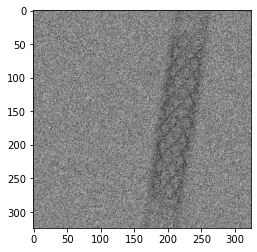

Predicted image:


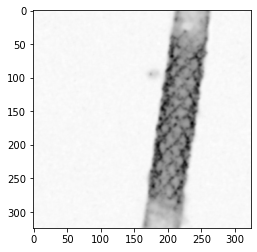

Ground truth:


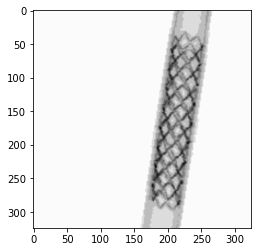

 67%|██████▋   | 2010/3000 [4:58:07<2:40:48,  9.75s/it]

Epoch [1/1], Step [2011/3000], Loss: 0.0003888049
Original image:


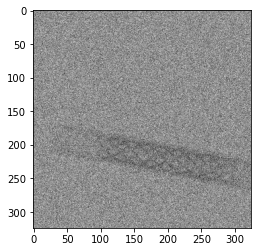

Predicted image:


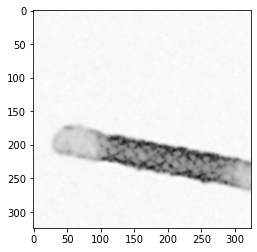

Ground truth:


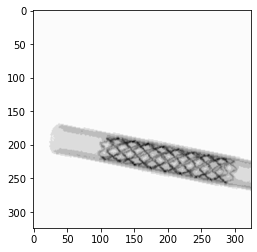

 67%|██████▋   | 2020/3000 [4:59:34<2:22:10,  8.70s/it]

Epoch [1/1], Step [2021/3000], Loss: 0.0001606742
Original image:


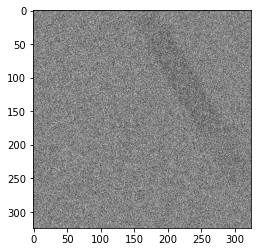

Predicted image:


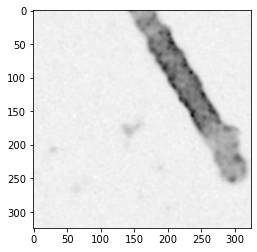

Ground truth:


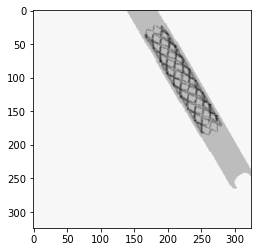

 68%|██████▊   | 2030/3000 [5:01:03<2:24:59,  8.97s/it]

Epoch [1/1], Step [2031/3000], Loss: 0.0001876709
Original image:


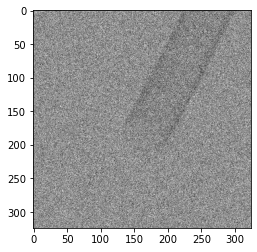

Predicted image:


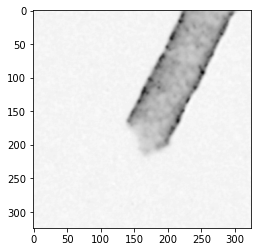

Ground truth:


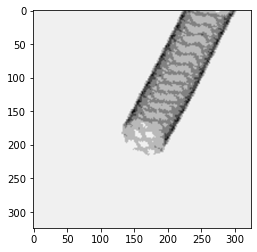

 68%|██████▊   | 2040/3000 [5:02:30<2:23:38,  8.98s/it]

Epoch [1/1], Step [2041/3000], Loss: 0.0001199311
Original image:


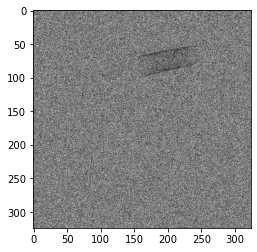

Predicted image:


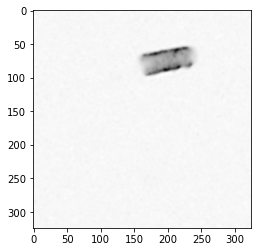

Ground truth:


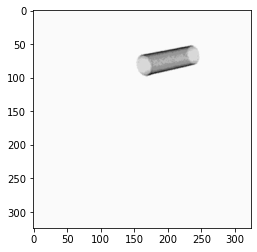

 68%|██████▊   | 2050/3000 [5:03:57<2:20:20,  8.86s/it]

Epoch [1/1], Step [2051/3000], Loss: 0.0000581734
Original image:


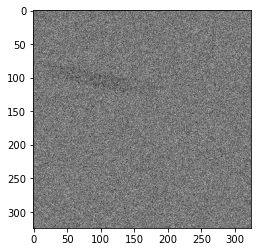

Predicted image:


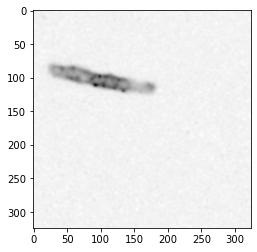

Ground truth:


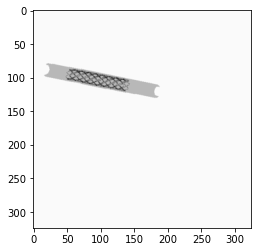

 69%|██████▊   | 2060/3000 [5:05:24<2:20:47,  8.99s/it]

Epoch [1/1], Step [2061/3000], Loss: 0.0001162330
Original image:


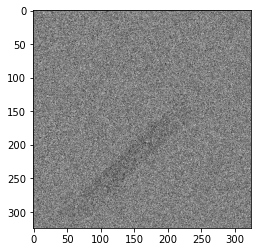

Predicted image:


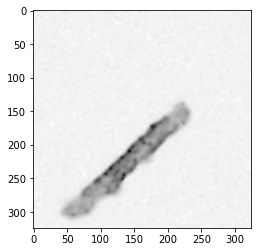

Ground truth:


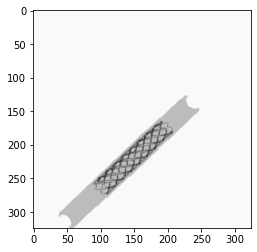

 69%|██████▉   | 2070/3000 [5:07:08<3:01:33, 11.71s/it]

Epoch [1/1], Step [2071/3000], Loss: 0.0001703540
Original image:


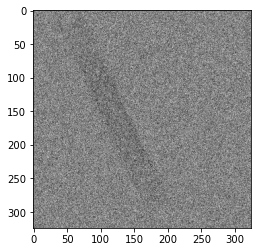

Predicted image:


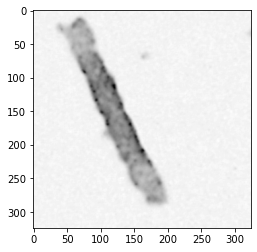

Ground truth:


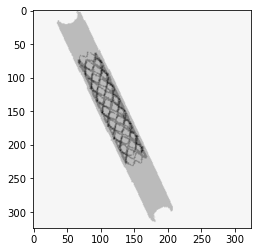

 69%|██████▉   | 2080/3000 [5:09:39<3:50:51, 15.06s/it]

Epoch [1/1], Step [2081/3000], Loss: 0.0002094165
Original image:


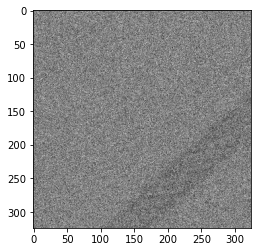

Predicted image:


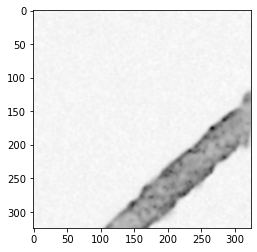

Ground truth:


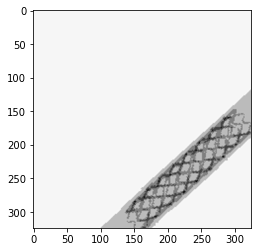

 69%|██████▉   | 2083/3000 [5:10:36<2:16:44,  8.95s/it]


KeyboardInterrupt: 

In [131]:
# training
for i, data in enumerate(tqdm(data_loader)):
    # get the inputs
    inputs, targets = data
    # zero the parameter gradients
    optimizer.zero_grad()
    # forward + backward + optimize
    outputs = model(inputs)
    loss = criterion(outputs, targets)
    loss.backward()
    optimizer.step()
    # print statistics
    losses.append(loss.item())
    if i % 10 == 0:
        print('Step [{}/{}], Loss: {:.10f}'.format(i+1, len(data_loader), loss.item()))
    if i < 200 and i % 20 == 0 or i % 10 == 0:
        print("Original image:")
        plt.figure()
        plt.imshow(inputs.detach().numpy()[0][94:-94, 94:-94], cmap="gray")
        plt.show()
        print("Predicted image:")
        plt.figure()
        plt.imshow(outputs.detach().numpy()[0], cmap="gray")
        plt.show()
        print("Ground truth:")
        plt.figure()
        plt.imshow(targets.detach().numpy()[0], cmap="gray")
        plt.show()

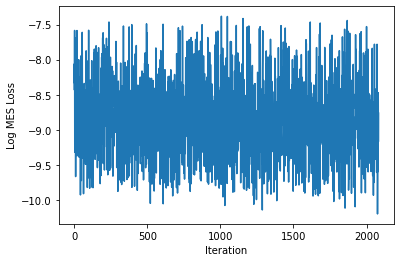

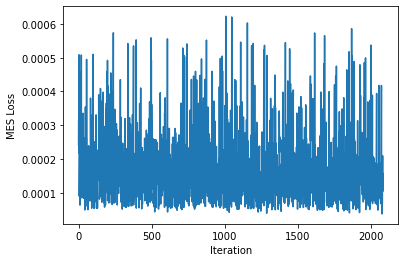

In [133]:
# plot the log loss
plt.plot(np.log(losses))
plt.xlabel("Iteration")
plt.ylabel("Log MES Loss")
plt.show()

# plot the loss
plt.plot(losses)
plt.xlabel("Iteration")
plt.ylabel("MES Loss")
plt.show()

In [134]:
# save the model
torch.save(model.state_dict(), f"./weights/unet-weights_{previous_iter_count + n_images}.pt")

# use pickle to save the model
with open(f"./weights/unet-model_{previous_iter_count + n_images}.pkl", "wb") as f:
    pickle.dump(model, f)

In [135]:
# save the losses
with open(f"./weights/unet-losses-{previous_iter_count + n_images}.pkl", "wb") as f:
    pickle.dump(losses, f)